# Generating Handwritten Digit Images with GANs in PyTorch
In this project, we will implement a Generative Adversarial Network (GAN) using PyTorch to generate images of handwritten digits resembling those in the MNIST dataset. By the end of this notebook, you'll have a working GAN capable of producing realistic digit images, and you'll understand the underlying concepts driving this process.

**Introduction to GANs**

Generative Adversarial Networks (GANs) are a class of neural networks introduced by Ian Goodfellow in 2014. GANs consist of two models:

Generator (G): Learns to generate fake data resembling the real data.

Discriminator (D): Learns to distinguish between real and fake data.

The generator and discriminator are trained simultaneously in an adversarial process. The generator tries to produce data that is indistinguishable from real data to fool the discriminator, while the discriminator aims to accurately classify real and generated data.

This adversarial training results in the generator producing highly realistic data over time, making GANs powerful tools for data generation tasks.

**About the MNIST Dataset**

The MNIST dataset is a large database of handwritten digits commonly used for training and testing in the field of machine learning. It contains:

60,000 training images

10,000 test images

Each image is a 28x28 pixel grayscale image of handwritten digits from 0 to 9, making it ten classes in total.

Our goal is to train a generator that can produce new, synthetic images of handwritten digits that look similar to those in the MNIST dataset.

**Importing Libraries**

First, let's import the necessary libraries for our project.

In [ ]:
# Import necessary libraries
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np

**Setting Up the Device**

For faster training, we'll utilize a GPU if available.

In [ ]:
# Set up device (CPU or GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cpu


**Preparing the Dataset**

We need to load the MNIST dataset and apply necessary transformations.

In [ ]:
# Define transformations for the dataset
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))  # Normalize images to [-1, 1]
])

# Load the MNIST dataset
batch_size = 128

train_dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

Explanation:

- Transforms: We convert images to tensors and normalize the pixel values to the range [-1, 1] to match the output range of the generator's tanh activation function.

- DataLoader: We use a DataLoader to load the dataset in batches, which is essential for training neural networks efficiently.

**Defining the Generator Network**

The generator takes a random noise vector as input and outputs a 28x28 image.

In [ ]:
# Define the Generator network
class Generator(nn.Module):
    def __init__(self, input_size, feature_size):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.Linear(input_size, feature_size * 4),
            nn.ReLU(True),
            nn.Linear(feature_size * 4, feature_size * 8),
            nn.ReLU(True),
            nn.Linear(feature_size * 8, feature_size * 16),
            nn.ReLU(True),
            nn.Linear(feature_size * 16, 28 * 28),
            nn.Tanh()
        )

    def forward(self, input):
        output = self.main(input)
        return output.view(-1, 1, 28, 28)

Explanation:

- Input: A random noise vector of size input_size (e.g., 100).

- Layers: A series of linear layers with increasing feature sizes, using ReLU activations.

- Output Layer: Uses Tanh activation to ensure output pixel values are in the range [-1, 1].

**Defining the Discriminator Network**

The discriminator takes an image as input and outputs a scalar probability that the image is real.

In [ ]:
# Define the Discriminator network
class Discriminator(nn.Module):
    def __init__(self, feature_size):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Linear(28 * 28, feature_size * 16),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(feature_size * 16, feature_size * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(feature_size * 8, feature_size * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(feature_size * 4, 1),
            nn.Sigmoid()
        )

    def forward(self, input):
        input = input.view(-1, 28 * 28)
        output = self.main(input)
        return output

Explanation:

- Input: A 28x28 image flattened into a vector.

- Layers: A series of linear layers with decreasing feature sizes, using LeakyReLU activations to allow for better gradient flow.

- Output Layer: Uses Sigmoid activation to output a probability between 0 and 1.

**Setting Hyperparameters and Initializing Models**

We define key hyperparameters and instantiate the generator and discriminator models.

In [ ]:
# Hyperparameters
noise_size = 100      # Size of the noise vector
feature_size = 64     # Base feature size for networks
num_epochs = 150       # Number of training epochs
learning_rate = 0.0002  # Learning rate for optimizers

# Create instances of the Generator and Discriminator
G = Generator(noise_size, feature_size).to(device)
D = Discriminator(feature_size).to(device)

Explanation:

- noise_size: The dimension of the input noise vector to the generator.

- feature_size: Determines the size of the hidden layers in both networks.

- num_epochs: Number of times the entire dataset passes through the training loop.

- learning_rate: Controls how much to update the model's weights during training.

**Defining Loss Function and Optimizers**

We set up the loss function and optimizers for both networks.

In [ ]:
# Loss function and optimizers
criterion = nn.BCELoss()
optimizerD = optim.Adam(D.parameters(), lr=learning_rate)
optimizerG = optim.Adam(G.parameters(), lr=learning_rate)

# Labels for real and fake data
real_label = 1.
fake_label = 0.

Explanation:

- Loss Function: Binary Cross Entropy Loss (nn.BCELoss) measures the error between the predicted outputs and the actual labels (real or fake).

- Optimizers: We use the Adam optimizer for both networks, which adapts the learning rate during training.

- Labels: We define labels for real (1) and fake (0) images to train the discriminator.

**Training the GAN**

Now, we'll train our GAN model by updating both the generator and discriminator in each iteration.

Starting Training...
[1/150][0/469]	Loss_D: 1.3810	Loss_G: 0.6865	D(x): 0.5065	D(G(z)): 0.5038/0.5034
[1/150][100/469]	Loss_D: 0.5682	Loss_G: 1.3128	D(x): 0.9925	D(G(z)): 0.4257/0.2708
[1/150][200/469]	Loss_D: 0.0685	Loss_G: 5.3312	D(x): 0.9858	D(G(z)): 0.0076/0.0051
[1/150][300/469]	Loss_D: 0.0271	Loss_G: 12.7978	D(x): 0.9929	D(G(z)): 0.0095/0.0000
[1/150][400/469]	Loss_D: 0.0362	Loss_G: 5.2479	D(x): 0.9990	D(G(z)): 0.0346/0.0053


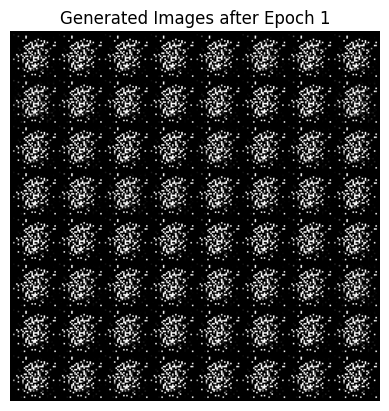

[2/150][0/469]	Loss_D: 0.0358	Loss_G: 6.7661	D(x): 0.9880	D(G(z)): 0.0227/0.0012
[2/150][100/469]	Loss_D: 0.0519	Loss_G: 8.0469	D(x): 0.9729	D(G(z)): 0.0214/0.0004
[2/150][200/469]	Loss_D: 0.4786	Loss_G: 11.8473	D(x): 0.9328	D(G(z)): 0.1472/0.0006
[2/150][300/469]	Loss_D: 0.0122	Loss_G: 7.2331	D(x): 0.9944	D(G(z)): 0.0053/0.0025
[2/150][400/469]	Loss_D: 0.2369	Loss_G: 4.1184	D(x): 0.9957	D(G(z)): 0.1785/0.0271


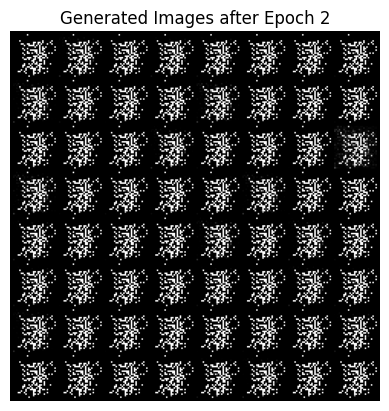

[3/150][0/469]	Loss_D: 0.0084	Loss_G: 10.1356	D(x): 0.9921	D(G(z)): 0.0001/0.0001
[3/150][100/469]	Loss_D: 0.0269	Loss_G: 5.3404	D(x): 0.9819	D(G(z)): 0.0070/0.0051
[3/150][200/469]	Loss_D: 0.0414	Loss_G: 8.7290	D(x): 0.9678	D(G(z)): 0.0019/0.0015
[3/150][300/469]	Loss_D: 0.0187	Loss_G: 7.0688	D(x): 0.9954	D(G(z)): 0.0134/0.0040
[3/150][400/469]	Loss_D: 0.1489	Loss_G: 9.1251	D(x): 0.9664	D(G(z)): 0.0934/0.0178


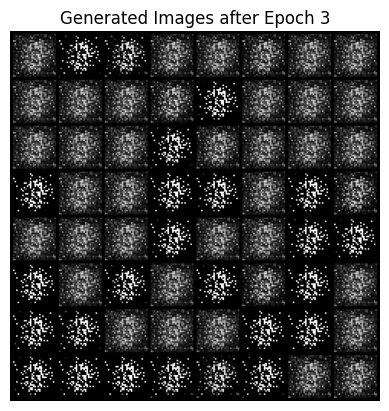

[4/150][0/469]	Loss_D: 0.4358	Loss_G: 9.8990	D(x): 0.8697	D(G(z)): 0.1017/0.0031
[4/150][100/469]	Loss_D: 0.1763	Loss_G: 25.6930	D(x): 0.9630	D(G(z)): 0.0672/0.0078
[4/150][200/469]	Loss_D: 0.8996	Loss_G: 6.7705	D(x): 0.8410	D(G(z)): 0.3055/0.0325
[4/150][300/469]	Loss_D: 0.9996	Loss_G: 15.9795	D(x): 0.9152	D(G(z)): 0.3614/0.0451
[4/150][400/469]	Loss_D: 0.1867	Loss_G: 5.3820	D(x): 0.9156	D(G(z)): 0.0698/0.0300


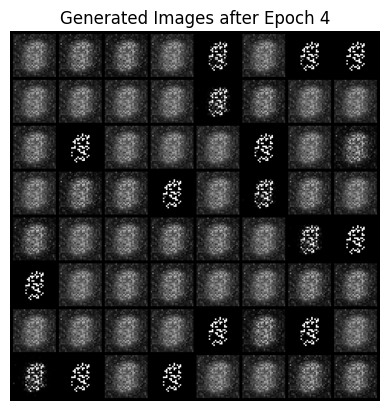

[5/150][0/469]	Loss_D: 0.3421	Loss_G: 8.6421	D(x): 0.9079	D(G(z)): 0.1511/0.0691
[5/150][100/469]	Loss_D: 0.1345	Loss_G: 4.4019	D(x): 0.9592	D(G(z)): 0.0724/0.0256
[5/150][200/469]	Loss_D: 0.5527	Loss_G: 3.3028	D(x): 0.8059	D(G(z)): 0.2246/0.0741
[5/150][300/469]	Loss_D: 0.4484	Loss_G: 3.0743	D(x): 0.8694	D(G(z)): 0.2074/0.0539
[5/150][400/469]	Loss_D: 0.3049	Loss_G: 3.1932	D(x): 0.8910	D(G(z)): 0.1079/0.0881


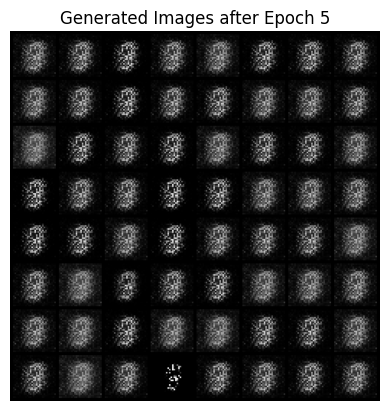

[6/150][0/469]	Loss_D: 0.3286	Loss_G: 3.3165	D(x): 0.9064	D(G(z)): 0.1664/0.0645
[6/150][100/469]	Loss_D: 0.2104	Loss_G: 8.3817	D(x): 0.9315	D(G(z)): 0.0448/0.0199
[6/150][200/469]	Loss_D: 0.4517	Loss_G: 6.0429	D(x): 0.8707	D(G(z)): 0.1307/0.0150
[6/150][300/469]	Loss_D: 0.0745	Loss_G: 11.1809	D(x): 0.9678	D(G(z)): 0.0129/0.0026
[6/150][400/469]	Loss_D: 0.4519	Loss_G: 3.6854	D(x): 0.8569	D(G(z)): 0.1919/0.1622


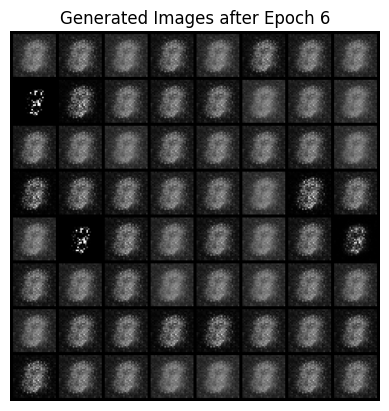

[7/150][0/469]	Loss_D: 1.4022	Loss_G: 1.0223	D(x): 0.6544	D(G(z)): 0.4997/0.4085
[7/150][100/469]	Loss_D: 0.7820	Loss_G: 1.6108	D(x): 0.7697	D(G(z)): 0.2719/0.2310
[7/150][200/469]	Loss_D: 0.2831	Loss_G: 2.7678	D(x): 0.9103	D(G(z)): 0.1296/0.0798
[7/150][300/469]	Loss_D: 0.3577	Loss_G: 4.5813	D(x): 0.8647	D(G(z)): 0.1058/0.0386
[7/150][400/469]	Loss_D: 0.1807	Loss_G: 3.1146	D(x): 0.9526	D(G(z)): 0.0900/0.0501


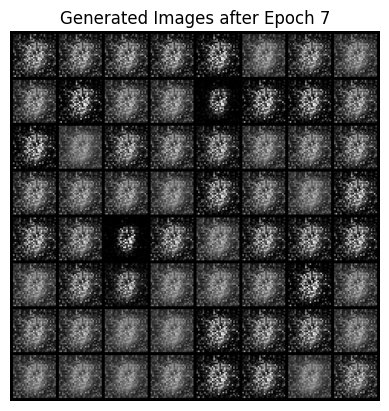

[8/150][0/469]	Loss_D: 0.2192	Loss_G: 4.2875	D(x): 0.9371	D(G(z)): 0.1080/0.0297
[8/150][100/469]	Loss_D: 0.0900	Loss_G: 3.8235	D(x): 0.9660	D(G(z)): 0.0403/0.0330
[8/150][200/469]	Loss_D: 0.0896	Loss_G: 5.6279	D(x): 0.9706	D(G(z)): 0.0364/0.0140
[8/150][300/469]	Loss_D: 0.0410	Loss_G: 5.5862	D(x): 0.9900	D(G(z)): 0.0285/0.0135
[8/150][400/469]	Loss_D: 0.4618	Loss_G: 3.3057	D(x): 0.8521	D(G(z)): 0.0907/0.0444


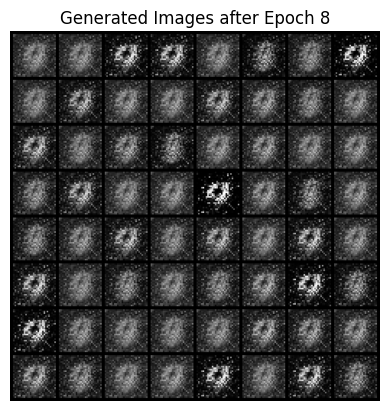

[9/150][0/469]	Loss_D: 0.0832	Loss_G: 5.4183	D(x): 0.9785	D(G(z)): 0.0378/0.0150
[9/150][100/469]	Loss_D: 0.0666	Loss_G: 5.8575	D(x): 0.9987	D(G(z)): 0.0340/0.0122
[9/150][200/469]	Loss_D: 0.1673	Loss_G: 6.3920	D(x): 0.9361	D(G(z)): 0.0045/0.0047
[9/150][300/469]	Loss_D: 0.1842	Loss_G: 6.6803	D(x): 0.9709	D(G(z)): 0.0883/0.0108
[9/150][400/469]	Loss_D: 0.1834	Loss_G: 3.9324	D(x): 0.9577	D(G(z)): 0.0706/0.0590


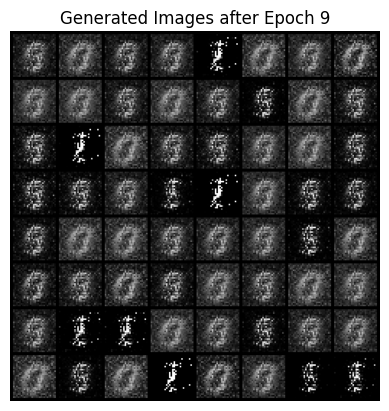

[10/150][0/469]	Loss_D: 0.1594	Loss_G: 5.9443	D(x): 0.9786	D(G(z)): 0.0692/0.0313
[10/150][100/469]	Loss_D: 0.0266	Loss_G: 8.2624	D(x): 0.9973	D(G(z)): 0.0211/0.0061
[10/150][200/469]	Loss_D: 0.1411	Loss_G: 4.0097	D(x): 0.9876	D(G(z)): 0.0874/0.0385
[10/150][300/469]	Loss_D: 0.1554	Loss_G: 6.8789	D(x): 0.9630	D(G(z)): 0.0494/0.0090
[10/150][400/469]	Loss_D: 0.3272	Loss_G: 4.5839	D(x): 0.9615	D(G(z)): 0.1329/0.0785


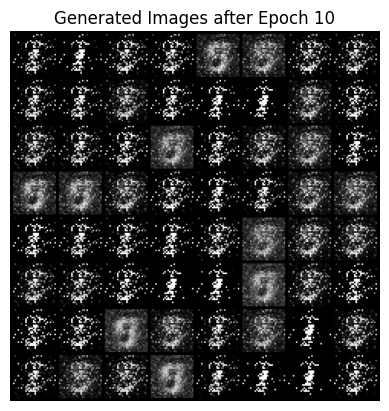

[11/150][0/469]	Loss_D: 0.4709	Loss_G: 5.9395	D(x): 0.8970	D(G(z)): 0.1461/0.0445
[11/150][100/469]	Loss_D: 0.4210	Loss_G: 5.1408	D(x): 0.8955	D(G(z)): 0.1201/0.0575
[11/150][200/469]	Loss_D: 0.4719	Loss_G: 6.8346	D(x): 0.8932	D(G(z)): 0.0486/0.0118
[11/150][300/469]	Loss_D: 0.1785	Loss_G: 3.9596	D(x): 0.9685	D(G(z)): 0.0561/0.0355
[11/150][400/469]	Loss_D: 0.1732	Loss_G: 5.6645	D(x): 0.9510	D(G(z)): 0.0258/0.0051


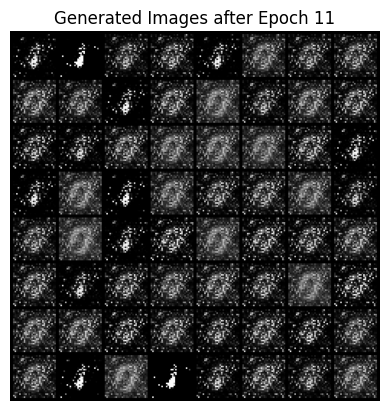

[12/150][0/469]	Loss_D: 0.1883	Loss_G: 6.1171	D(x): 0.9454	D(G(z)): 0.0642/0.0032
[12/150][100/469]	Loss_D: 0.3267	Loss_G: 5.9833	D(x): 0.9508	D(G(z)): 0.1578/0.0115
[12/150][200/469]	Loss_D: 0.1655	Loss_G: 5.3885	D(x): 0.9619	D(G(z)): 0.0852/0.0072
[12/150][300/469]	Loss_D: 0.3293	Loss_G: 4.7663	D(x): 0.8888	D(G(z)): 0.0646/0.0299
[12/150][400/469]	Loss_D: 0.1538	Loss_G: 8.5829	D(x): 0.9727	D(G(z)): 0.0437/0.0048


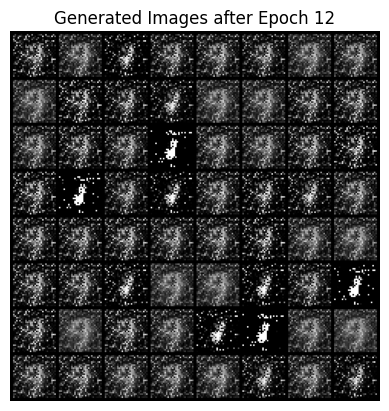

[13/150][0/469]	Loss_D: 0.1832	Loss_G: 5.3204	D(x): 0.9613	D(G(z)): 0.1017/0.0068
[13/150][100/469]	Loss_D: 0.1853	Loss_G: 10.2167	D(x): 0.9852	D(G(z)): 0.0578/0.0296
[13/150][200/469]	Loss_D: 0.1503	Loss_G: 5.1119	D(x): 0.9598	D(G(z)): 0.0290/0.0211
[13/150][300/469]	Loss_D: 0.3482	Loss_G: 5.9826	D(x): 0.9412	D(G(z)): 0.0545/0.0124
[13/150][400/469]	Loss_D: 0.1475	Loss_G: 4.3984	D(x): 0.9552	D(G(z)): 0.0648/0.0197


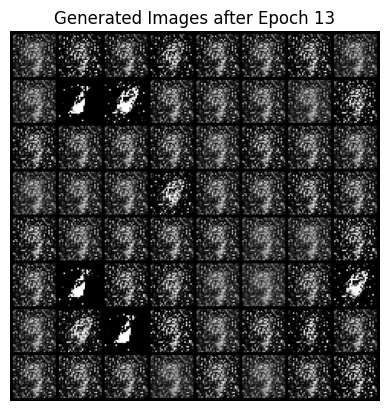

[14/150][0/469]	Loss_D: 0.0622	Loss_G: 5.6222	D(x): 0.9749	D(G(z)): 0.0233/0.0066
[14/150][100/469]	Loss_D: 0.2217	Loss_G: 5.0011	D(x): 0.9196	D(G(z)): 0.0254/0.0226
[14/150][200/469]	Loss_D: 0.0443	Loss_G: 8.0955	D(x): 0.9874	D(G(z)): 0.0242/0.0022
[14/150][300/469]	Loss_D: 0.3420	Loss_G: 5.7687	D(x): 0.9283	D(G(z)): 0.1067/0.0277
[14/150][400/469]	Loss_D: 0.1940	Loss_G: 4.1844	D(x): 0.9585	D(G(z)): 0.0817/0.0363


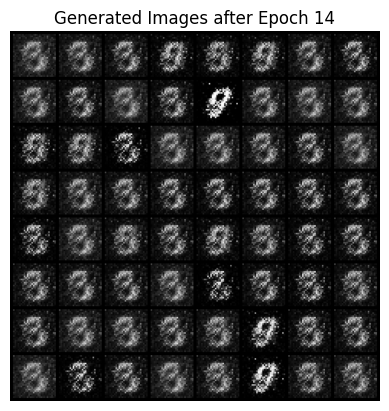

[15/150][0/469]	Loss_D: 0.1262	Loss_G: 5.9446	D(x): 0.9550	D(G(z)): 0.0300/0.0050
[15/150][100/469]	Loss_D: 0.1029	Loss_G: 6.6997	D(x): 0.9668	D(G(z)): 0.0285/0.0047
[15/150][200/469]	Loss_D: 0.2127	Loss_G: 4.2561	D(x): 0.9343	D(G(z)): 0.0645/0.0268
[15/150][300/469]	Loss_D: 0.1791	Loss_G: 4.5307	D(x): 0.9362	D(G(z)): 0.0446/0.0213
[15/150][400/469]	Loss_D: 0.0946	Loss_G: 7.2403	D(x): 0.9742	D(G(z)): 0.0450/0.0041


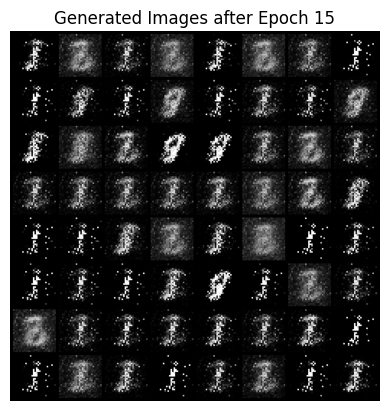

[16/150][0/469]	Loss_D: 0.6645	Loss_G: 11.5421	D(x): 0.9762	D(G(z)): 0.3491/0.0002
[16/150][100/469]	Loss_D: 0.3877	Loss_G: 4.4071	D(x): 0.9308	D(G(z)): 0.1875/0.0418
[16/150][200/469]	Loss_D: 0.2944	Loss_G: 4.3492	D(x): 0.9074	D(G(z)): 0.0200/0.0302
[16/150][300/469]	Loss_D: 0.1531	Loss_G: 4.3052	D(x): 0.9458	D(G(z)): 0.0374/0.0311
[16/150][400/469]	Loss_D: 0.3932	Loss_G: 5.7195	D(x): 0.9354	D(G(z)): 0.1401/0.0493


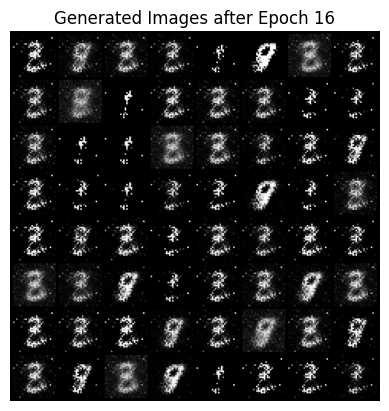

[17/150][0/469]	Loss_D: 0.1505	Loss_G: 7.8383	D(x): 0.9573	D(G(z)): 0.0052/0.0042
[17/150][100/469]	Loss_D: 0.1628	Loss_G: 4.9027	D(x): 0.9288	D(G(z)): 0.0177/0.0174
[17/150][200/469]	Loss_D: 0.4198	Loss_G: 5.1233	D(x): 0.9672	D(G(z)): 0.2488/0.0109
[17/150][300/469]	Loss_D: 0.3553	Loss_G: 5.7306	D(x): 0.9293	D(G(z)): 0.1345/0.0444
[17/150][400/469]	Loss_D: 0.4333	Loss_G: 4.0568	D(x): 0.9741	D(G(z)): 0.2595/0.0820


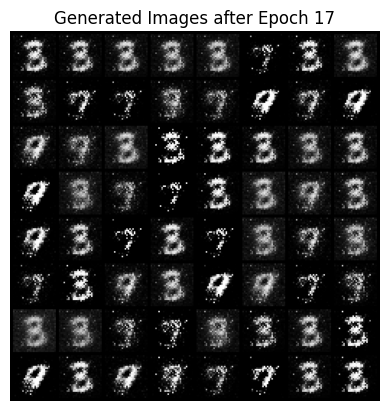

[18/150][0/469]	Loss_D: 0.2651	Loss_G: 4.0150	D(x): 0.9186	D(G(z)): 0.0954/0.0346
[18/150][100/469]	Loss_D: 0.2434	Loss_G: 4.6757	D(x): 0.9561	D(G(z)): 0.0751/0.0359
[18/150][200/469]	Loss_D: 0.5536	Loss_G: 4.6600	D(x): 0.8914	D(G(z)): 0.1531/0.0438
[18/150][300/469]	Loss_D: 0.5035	Loss_G: 3.6176	D(x): 0.9267	D(G(z)): 0.2603/0.0445
[18/150][400/469]	Loss_D: 0.1750	Loss_G: 5.9880	D(x): 0.9388	D(G(z)): 0.0716/0.0115


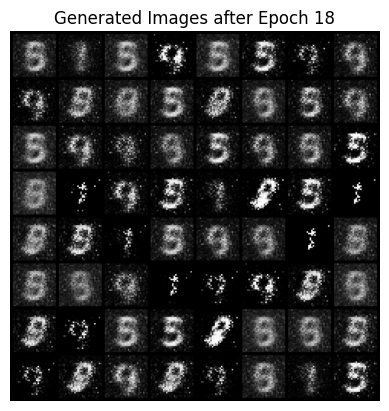

[19/150][0/469]	Loss_D: 0.3258	Loss_G: 4.0073	D(x): 0.8998	D(G(z)): 0.0225/0.0955
[19/150][100/469]	Loss_D: 0.3702	Loss_G: 5.2943	D(x): 0.8991	D(G(z)): 0.0599/0.0254
[19/150][200/469]	Loss_D: 0.3133	Loss_G: 3.7392	D(x): 0.8960	D(G(z)): 0.0420/0.0640
[19/150][300/469]	Loss_D: 0.1816	Loss_G: 4.9432	D(x): 0.9278	D(G(z)): 0.0420/0.0191
[19/150][400/469]	Loss_D: 0.2492	Loss_G: 4.4329	D(x): 0.9416	D(G(z)): 0.0978/0.0392


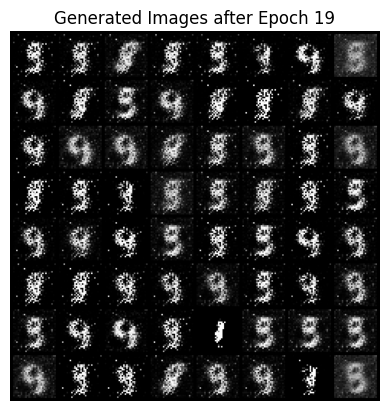

[20/150][0/469]	Loss_D: 0.1887	Loss_G: 8.3697	D(x): 0.9456	D(G(z)): 0.0337/0.0189
[20/150][100/469]	Loss_D: 0.3401	Loss_G: 5.2013	D(x): 0.8762	D(G(z)): 0.0529/0.0198
[20/150][200/469]	Loss_D: 0.5168	Loss_G: 4.4586	D(x): 0.8336	D(G(z)): 0.0466/0.0415
[20/150][300/469]	Loss_D: 0.3029	Loss_G: 5.1525	D(x): 0.9465	D(G(z)): 0.1465/0.0161
[20/150][400/469]	Loss_D: 0.2231	Loss_G: 9.1761	D(x): 0.9473	D(G(z)): 0.0514/0.0014


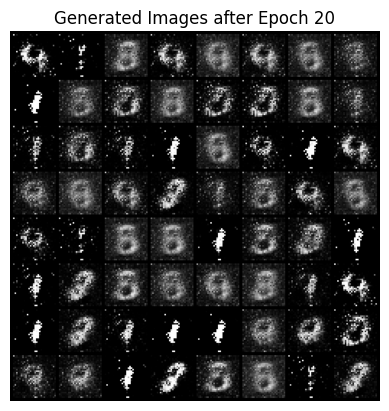

[21/150][0/469]	Loss_D: 0.4174	Loss_G: 5.2730	D(x): 0.8827	D(G(z)): 0.0296/0.0200
[21/150][100/469]	Loss_D: 0.3587	Loss_G: 4.4954	D(x): 0.9209	D(G(z)): 0.1104/0.0759
[21/150][200/469]	Loss_D: 0.3377	Loss_G: 7.7698	D(x): 0.8750	D(G(z)): 0.0396/0.0147
[21/150][300/469]	Loss_D: 0.7374	Loss_G: 3.4614	D(x): 0.8270	D(G(z)): 0.1207/0.0864
[21/150][400/469]	Loss_D: 0.1280	Loss_G: 5.9639	D(x): 0.9406	D(G(z)): 0.0106/0.0049


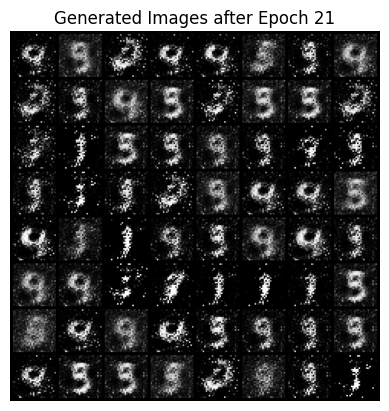

[22/150][0/469]	Loss_D: 0.4784	Loss_G: 5.5126	D(x): 0.8930	D(G(z)): 0.1146/0.0255
[22/150][100/469]	Loss_D: 0.7471	Loss_G: 7.2530	D(x): 0.9083	D(G(z)): 0.2472/0.0094
[22/150][200/469]	Loss_D: 0.3273	Loss_G: 5.5234	D(x): 0.9749	D(G(z)): 0.1803/0.0185
[22/150][300/469]	Loss_D: 0.3184	Loss_G: 5.6820	D(x): 0.9550	D(G(z)): 0.1228/0.0531
[22/150][400/469]	Loss_D: 0.1870	Loss_G: 4.0208	D(x): 0.9462	D(G(z)): 0.0759/0.0511


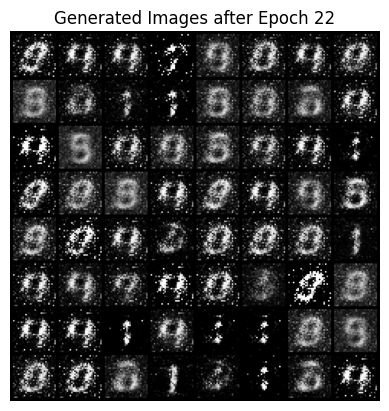

[23/150][0/469]	Loss_D: 0.3012	Loss_G: 4.8109	D(x): 0.9081	D(G(z)): 0.0887/0.0356
[23/150][100/469]	Loss_D: 0.3018	Loss_G: 3.5356	D(x): 0.9409	D(G(z)): 0.1399/0.0759
[23/150][200/469]	Loss_D: 0.2880	Loss_G: 5.1156	D(x): 0.9182	D(G(z)): 0.0793/0.0319
[23/150][300/469]	Loss_D: 0.3196	Loss_G: 5.9523	D(x): 0.9278	D(G(z)): 0.1161/0.0233
[23/150][400/469]	Loss_D: 0.4333	Loss_G: 4.6164	D(x): 0.9214	D(G(z)): 0.1763/0.0585


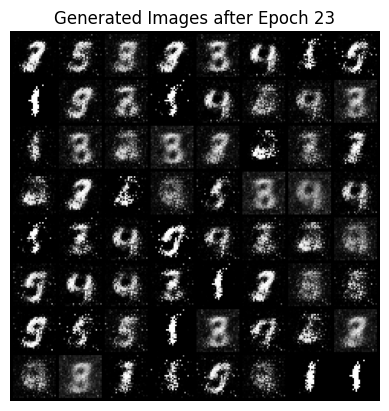

[24/150][0/469]	Loss_D: 0.3977	Loss_G: 4.3617	D(x): 0.8602	D(G(z)): 0.0812/0.0311
[24/150][100/469]	Loss_D: 0.4121	Loss_G: 4.5884	D(x): 0.8467	D(G(z)): 0.0304/0.0285
[24/150][200/469]	Loss_D: 0.4480	Loss_G: 4.4915	D(x): 0.8988	D(G(z)): 0.1806/0.0443
[24/150][300/469]	Loss_D: 0.3114	Loss_G: 4.1842	D(x): 0.9488	D(G(z)): 0.1508/0.0587
[24/150][400/469]	Loss_D: 0.5443	Loss_G: 4.6597	D(x): 0.8797	D(G(z)): 0.1987/0.0452


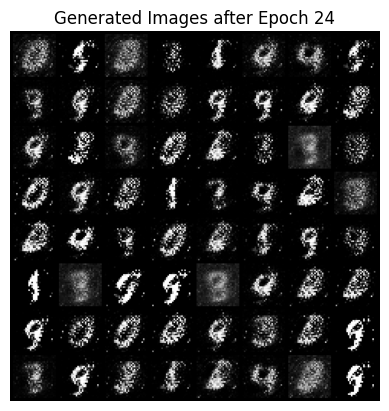

[25/150][0/469]	Loss_D: 0.2952	Loss_G: 4.2539	D(x): 0.8955	D(G(z)): 0.1065/0.0287
[25/150][100/469]	Loss_D: 0.5018	Loss_G: 4.2140	D(x): 0.9338	D(G(z)): 0.2580/0.0443
[25/150][200/469]	Loss_D: 0.1524	Loss_G: 3.1249	D(x): 0.9658	D(G(z)): 0.0791/0.0775
[25/150][300/469]	Loss_D: 0.3184	Loss_G: 4.1145	D(x): 0.8916	D(G(z)): 0.1079/0.0703
[25/150][400/469]	Loss_D: 0.2323	Loss_G: 3.1368	D(x): 0.9137	D(G(z)): 0.0548/0.0921


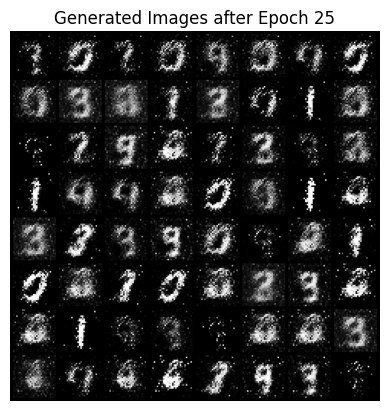

[26/150][0/469]	Loss_D: 0.3244	Loss_G: 4.0645	D(x): 0.8819	D(G(z)): 0.0485/0.0417
[26/150][100/469]	Loss_D: 0.4485	Loss_G: 7.8704	D(x): 0.9099	D(G(z)): 0.1445/0.0086
[26/150][200/469]	Loss_D: 0.3170	Loss_G: 5.6205	D(x): 0.8778	D(G(z)): 0.0401/0.0222
[26/150][300/469]	Loss_D: 0.3937	Loss_G: 3.4527	D(x): 0.8427	D(G(z)): 0.0670/0.0659
[26/150][400/469]	Loss_D: 0.3792	Loss_G: 5.2619	D(x): 0.8838	D(G(z)): 0.0835/0.0258


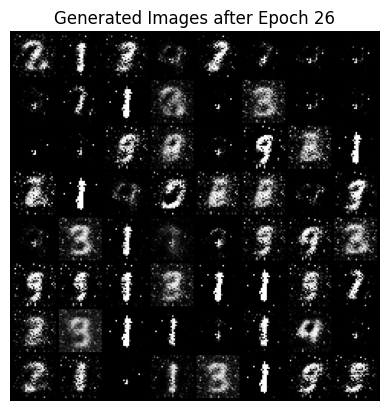

[27/150][0/469]	Loss_D: 0.2555	Loss_G: 6.9336	D(x): 0.9090	D(G(z)): 0.0611/0.0059
[27/150][100/469]	Loss_D: 0.2258	Loss_G: 4.3133	D(x): 0.9471	D(G(z)): 0.0962/0.0366
[27/150][200/469]	Loss_D: 0.1822	Loss_G: 6.0118	D(x): 0.9427	D(G(z)): 0.0615/0.0082
[27/150][300/469]	Loss_D: 0.2274	Loss_G: 5.4894	D(x): 0.9072	D(G(z)): 0.0285/0.0157
[27/150][400/469]	Loss_D: 0.1333	Loss_G: 4.9038	D(x): 0.9793	D(G(z)): 0.0803/0.0230


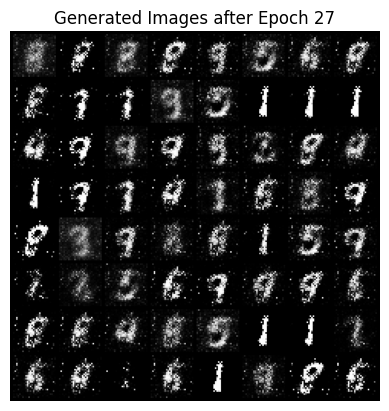

[28/150][0/469]	Loss_D: 0.6104	Loss_G: 3.7809	D(x): 0.9117	D(G(z)): 0.1877/0.0594
[28/150][100/469]	Loss_D: 0.3567	Loss_G: 5.0625	D(x): 0.9467	D(G(z)): 0.1579/0.0531
[28/150][200/469]	Loss_D: 0.2607	Loss_G: 6.1565	D(x): 0.9166	D(G(z)): 0.0420/0.0103
[28/150][300/469]	Loss_D: 0.3035	Loss_G: 3.1555	D(x): 0.9018	D(G(z)): 0.0780/0.0995
[28/150][400/469]	Loss_D: 0.3221	Loss_G: 4.6123	D(x): 0.8869	D(G(z)): 0.0793/0.0317


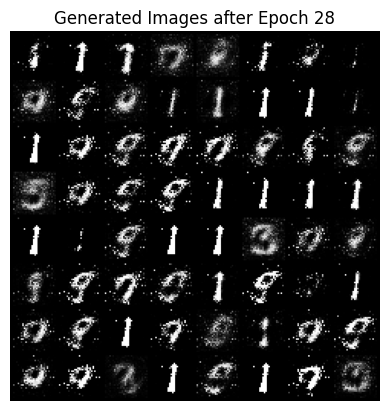

[29/150][0/469]	Loss_D: 0.2527	Loss_G: 3.7016	D(x): 0.9137	D(G(z)): 0.0830/0.0437
[29/150][100/469]	Loss_D: 0.2686	Loss_G: 4.6103	D(x): 0.9351	D(G(z)): 0.0852/0.0400
[29/150][200/469]	Loss_D: 0.3197	Loss_G: 4.0172	D(x): 0.9612	D(G(z)): 0.2003/0.0433
[29/150][300/469]	Loss_D: 0.2260	Loss_G: 5.4816	D(x): 0.9273	D(G(z)): 0.0687/0.0217
[29/150][400/469]	Loss_D: 0.2035	Loss_G: 5.5365	D(x): 0.9734	D(G(z)): 0.1016/0.0169


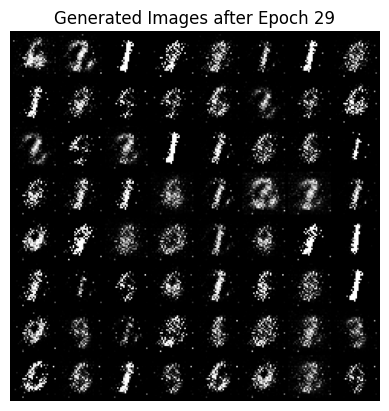

[30/150][0/469]	Loss_D: 0.4604	Loss_G: 5.4758	D(x): 0.8992	D(G(z)): 0.0460/0.0677
[30/150][100/469]	Loss_D: 0.3578	Loss_G: 4.6844	D(x): 0.8548	D(G(z)): 0.0340/0.0403
[30/150][200/469]	Loss_D: 0.2374	Loss_G: 5.6111	D(x): 0.9536	D(G(z)): 0.0992/0.0265
[30/150][300/469]	Loss_D: 0.2410	Loss_G: 3.6498	D(x): 0.9111	D(G(z)): 0.0402/0.0626
[30/150][400/469]	Loss_D: 0.4428	Loss_G: 4.0823	D(x): 0.9582	D(G(z)): 0.2283/0.0745


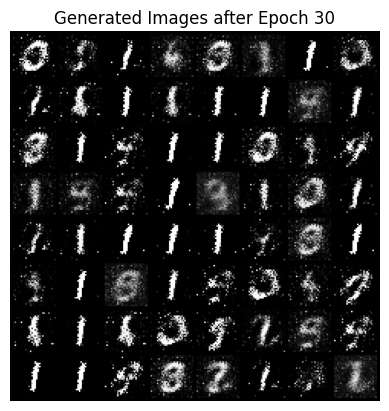

[31/150][0/469]	Loss_D: 0.1764	Loss_G: 4.4503	D(x): 0.9480	D(G(z)): 0.0854/0.0301
[31/150][100/469]	Loss_D: 0.3828	Loss_G: 5.9403	D(x): 0.8579	D(G(z)): 0.0386/0.0105
[31/150][200/469]	Loss_D: 0.2308	Loss_G: 4.7399	D(x): 0.9218	D(G(z)): 0.0762/0.0333
[31/150][300/469]	Loss_D: 0.3042	Loss_G: 5.1217	D(x): 0.9105	D(G(z)): 0.0669/0.0264
[31/150][400/469]	Loss_D: 0.2444	Loss_G: 4.7335	D(x): 0.9393	D(G(z)): 0.0616/0.0222


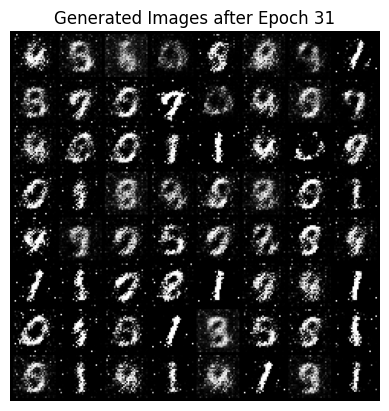

[32/150][0/469]	Loss_D: 0.2878	Loss_G: 4.7570	D(x): 0.9206	D(G(z)): 0.0695/0.0674
[32/150][100/469]	Loss_D: 0.4531	Loss_G: 7.6727	D(x): 0.8870	D(G(z)): 0.0256/0.0218
[32/150][200/469]	Loss_D: 0.3484	Loss_G: 4.3238	D(x): 0.9240	D(G(z)): 0.1120/0.0697
[32/150][300/469]	Loss_D: 0.3293	Loss_G: 4.1216	D(x): 0.8913	D(G(z)): 0.0573/0.0341
[32/150][400/469]	Loss_D: 0.1707	Loss_G: 3.2980	D(x): 0.9282	D(G(z)): 0.0533/0.0871


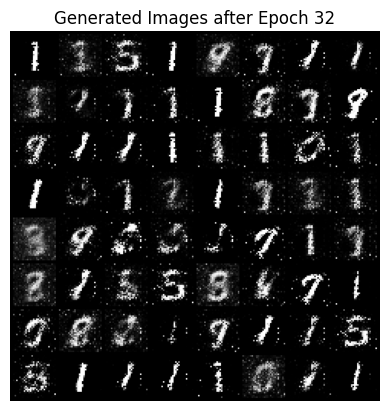

[33/150][0/469]	Loss_D: 0.4356	Loss_G: 2.7615	D(x): 0.8540	D(G(z)): 0.0390/0.1144
[33/150][100/469]	Loss_D: 0.3378	Loss_G: 4.8256	D(x): 0.8586	D(G(z)): 0.0298/0.0346
[33/150][200/469]	Loss_D: 0.3989	Loss_G: 3.8204	D(x): 0.8783	D(G(z)): 0.0879/0.0381
[33/150][300/469]	Loss_D: 0.3451	Loss_G: 4.8887	D(x): 0.8801	D(G(z)): 0.0242/0.0432
[33/150][400/469]	Loss_D: 0.2377	Loss_G: 5.2843	D(x): 0.9426	D(G(z)): 0.0803/0.0204


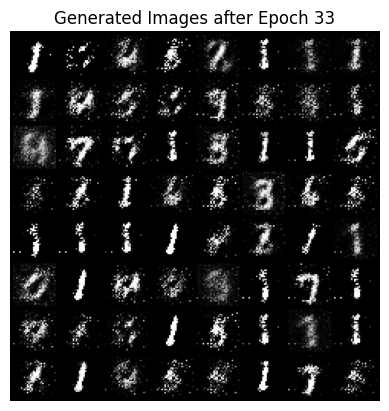

[34/150][0/469]	Loss_D: 0.3290	Loss_G: 4.2078	D(x): 0.9203	D(G(z)): 0.1142/0.0655
[34/150][100/469]	Loss_D: 0.3015	Loss_G: 4.5428	D(x): 0.9436	D(G(z)): 0.1259/0.0476
[34/150][200/469]	Loss_D: 0.2160	Loss_G: 4.7538	D(x): 0.9268	D(G(z)): 0.0780/0.0341
[34/150][300/469]	Loss_D: 0.2544	Loss_G: 3.3430	D(x): 0.9720	D(G(z)): 0.1417/0.0960
[34/150][400/469]	Loss_D: 0.3075	Loss_G: 3.1711	D(x): 0.9011	D(G(z)): 0.1206/0.0884


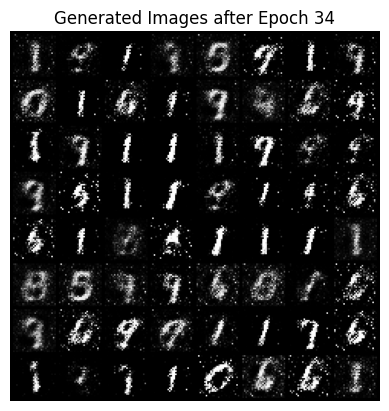

[35/150][0/469]	Loss_D: 0.3801	Loss_G: 6.0087	D(x): 0.9032	D(G(z)): 0.1290/0.0103
[35/150][100/469]	Loss_D: 0.4766	Loss_G: 3.8986	D(x): 0.8424	D(G(z)): 0.0535/0.0747
[35/150][200/469]	Loss_D: 0.2722	Loss_G: 3.8525	D(x): 0.9417	D(G(z)): 0.1345/0.0477
[35/150][300/469]	Loss_D: 0.4638	Loss_G: 3.7655	D(x): 0.9285	D(G(z)): 0.2010/0.0552
[35/150][400/469]	Loss_D: 0.2703	Loss_G: 3.1511	D(x): 0.9457	D(G(z)): 0.1391/0.0842


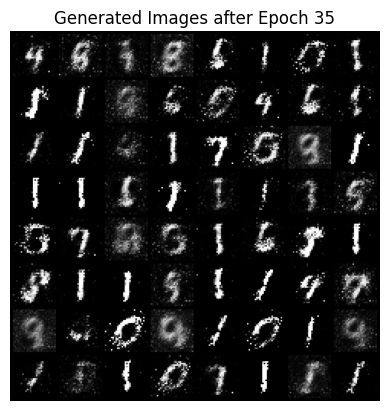

[36/150][0/469]	Loss_D: 0.3482	Loss_G: 1.7706	D(x): 0.9612	D(G(z)): 0.2027/0.2719
[36/150][100/469]	Loss_D: 0.1684	Loss_G: 4.1047	D(x): 0.9314	D(G(z)): 0.0606/0.0459
[36/150][200/469]	Loss_D: 0.3753	Loss_G: 5.8919	D(x): 0.8349	D(G(z)): 0.0107/0.0079
[36/150][300/469]	Loss_D: 0.2827	Loss_G: 3.3525	D(x): 0.9389	D(G(z)): 0.1140/0.0814
[36/150][400/469]	Loss_D: 0.2768	Loss_G: 4.2858	D(x): 0.9184	D(G(z)): 0.0734/0.0337


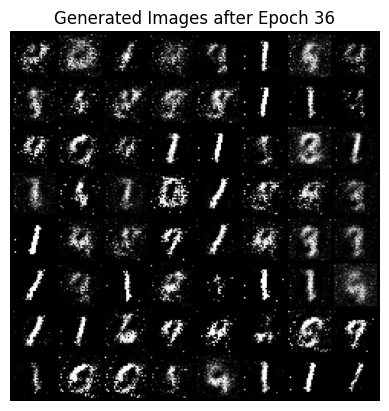

[37/150][0/469]	Loss_D: 0.5408	Loss_G: 4.1458	D(x): 0.9348	D(G(z)): 0.2062/0.0688
[37/150][100/469]	Loss_D: 0.3580	Loss_G: 4.3937	D(x): 0.8602	D(G(z)): 0.0502/0.0437
[37/150][200/469]	Loss_D: 0.4807	Loss_G: 3.2869	D(x): 0.8725	D(G(z)): 0.1672/0.0791
[37/150][300/469]	Loss_D: 0.4949	Loss_G: 3.9467	D(x): 0.9345	D(G(z)): 0.2148/0.0783
[37/150][400/469]	Loss_D: 0.2948	Loss_G: 3.0813	D(x): 0.8928	D(G(z)): 0.0985/0.0894


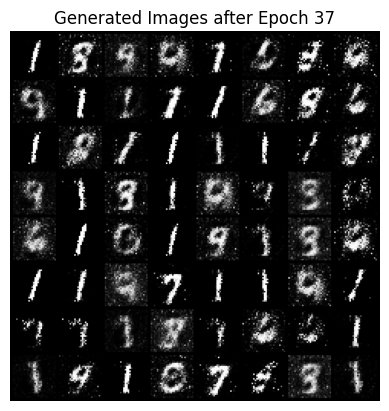

[38/150][0/469]	Loss_D: 0.4247	Loss_G: 4.3888	D(x): 0.8579	D(G(z)): 0.0881/0.0443
[38/150][100/469]	Loss_D: 0.1961	Loss_G: 4.1359	D(x): 0.9333	D(G(z)): 0.0590/0.0478
[38/150][200/469]	Loss_D: 0.3523	Loss_G: 4.3248	D(x): 0.9404	D(G(z)): 0.1574/0.0466
[38/150][300/469]	Loss_D: 0.4456	Loss_G: 2.6695	D(x): 0.8533	D(G(z)): 0.0363/0.1733
[38/150][400/469]	Loss_D: 0.3376	Loss_G: 3.8340	D(x): 0.9012	D(G(z)): 0.0920/0.0658


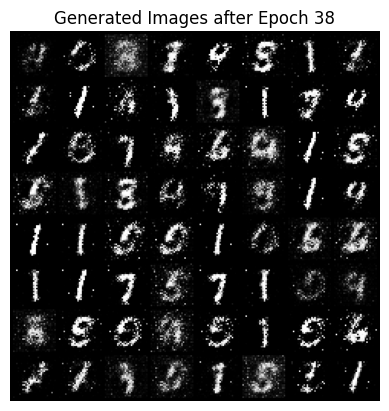

[39/150][0/469]	Loss_D: 0.5685	Loss_G: 3.0274	D(x): 0.8996	D(G(z)): 0.2692/0.1158
[39/150][100/469]	Loss_D: 0.5060	Loss_G: 4.3176	D(x): 0.9270	D(G(z)): 0.2212/0.0410
[39/150][200/469]	Loss_D: 0.3505	Loss_G: 3.7015	D(x): 0.8695	D(G(z)): 0.0341/0.0580
[39/150][300/469]	Loss_D: 0.2542	Loss_G: 4.3741	D(x): 0.9163	D(G(z)): 0.0865/0.0427
[39/150][400/469]	Loss_D: 0.3008	Loss_G: 3.7770	D(x): 0.8911	D(G(z)): 0.1062/0.0610


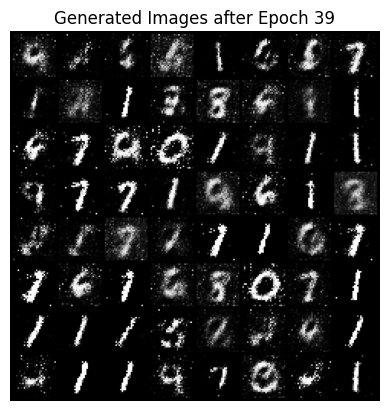

[40/150][0/469]	Loss_D: 0.3791	Loss_G: 3.8929	D(x): 0.9297	D(G(z)): 0.1743/0.0691
[40/150][100/469]	Loss_D: 0.8174	Loss_G: 4.0789	D(x): 0.9688	D(G(z)): 0.3845/0.0679
[40/150][200/469]	Loss_D: 0.4409	Loss_G: 3.6001	D(x): 0.8210	D(G(z)): 0.0355/0.0597
[40/150][300/469]	Loss_D: 0.2990	Loss_G: 3.6842	D(x): 0.9410	D(G(z)): 0.1419/0.0591
[40/150][400/469]	Loss_D: 0.3226	Loss_G: 3.4992	D(x): 0.8717	D(G(z)): 0.0663/0.0824


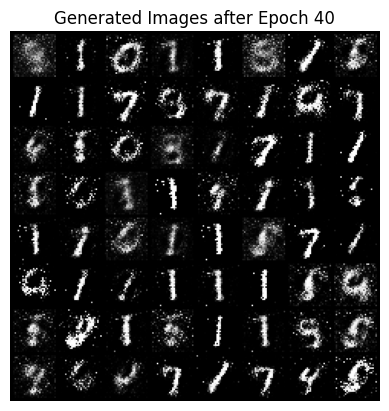

[41/150][0/469]	Loss_D: 0.4082	Loss_G: 3.4661	D(x): 0.9201	D(G(z)): 0.1619/0.0868
[41/150][100/469]	Loss_D: 0.3738	Loss_G: 3.5524	D(x): 0.9009	D(G(z)): 0.1220/0.0841
[41/150][200/469]	Loss_D: 0.4110	Loss_G: 4.1151	D(x): 0.8497	D(G(z)): 0.0920/0.0450
[41/150][300/469]	Loss_D: 0.4018	Loss_G: 2.8545	D(x): 0.8809	D(G(z)): 0.1106/0.1375
[41/150][400/469]	Loss_D: 0.3295	Loss_G: 3.2288	D(x): 0.9132	D(G(z)): 0.1345/0.0831


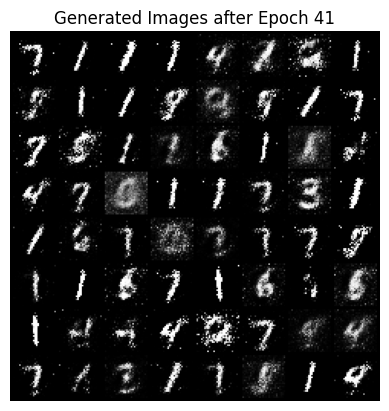

[42/150][0/469]	Loss_D: 0.3774	Loss_G: 3.1763	D(x): 0.8382	D(G(z)): 0.0764/0.1117
[42/150][100/469]	Loss_D: 0.2723	Loss_G: 4.5485	D(x): 0.8559	D(G(z)): 0.0420/0.0291
[42/150][200/469]	Loss_D: 0.5951	Loss_G: 2.3067	D(x): 0.8483	D(G(z)): 0.1414/0.1997
[42/150][300/469]	Loss_D: 0.4844	Loss_G: 3.7912	D(x): 0.8403	D(G(z)): 0.0721/0.0647
[42/150][400/469]	Loss_D: 0.2937	Loss_G: 4.3875	D(x): 0.8825	D(G(z)): 0.0658/0.0340


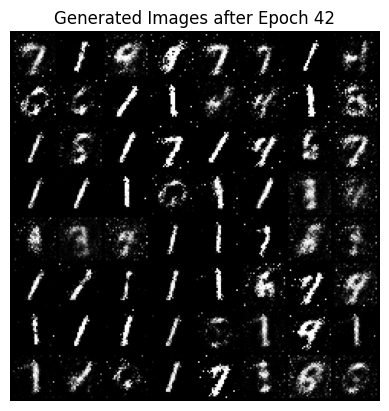

[43/150][0/469]	Loss_D: 0.3542	Loss_G: 2.7776	D(x): 0.8707	D(G(z)): 0.0988/0.1326
[43/150][100/469]	Loss_D: 0.3458	Loss_G: 3.8128	D(x): 0.9432	D(G(z)): 0.1421/0.0709
[43/150][200/469]	Loss_D: 0.2801	Loss_G: 3.2104	D(x): 0.9055	D(G(z)): 0.1021/0.0862
[43/150][300/469]	Loss_D: 0.3589	Loss_G: 4.7782	D(x): 0.8540	D(G(z)): 0.0605/0.0259
[43/150][400/469]	Loss_D: 0.3726	Loss_G: 4.5483	D(x): 0.8976	D(G(z)): 0.1388/0.0272


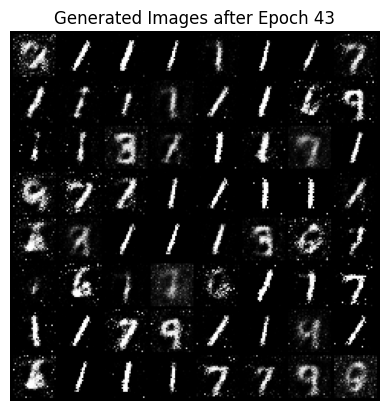

[44/150][0/469]	Loss_D: 0.5167	Loss_G: 2.6481	D(x): 0.8986	D(G(z)): 0.2218/0.1502
[44/150][100/469]	Loss_D: 0.4032	Loss_G: 3.9634	D(x): 0.8610	D(G(z)): 0.1057/0.0446
[44/150][200/469]	Loss_D: 0.5647	Loss_G: 3.5818	D(x): 0.8799	D(G(z)): 0.2071/0.0898
[44/150][300/469]	Loss_D: 0.4233	Loss_G: 4.3093	D(x): 0.8300	D(G(z)): 0.0370/0.0569
[44/150][400/469]	Loss_D: 0.3572	Loss_G: 4.2593	D(x): 0.8701	D(G(z)): 0.0494/0.0370


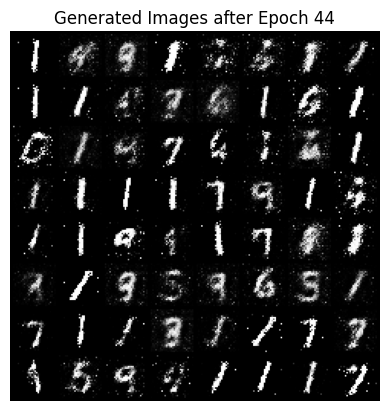

[45/150][0/469]	Loss_D: 0.2748	Loss_G: 2.6566	D(x): 0.9110	D(G(z)): 0.1066/0.1326
[45/150][100/469]	Loss_D: 0.2083	Loss_G: 4.4194	D(x): 0.9454	D(G(z)): 0.0959/0.0415
[45/150][200/469]	Loss_D: 0.4183	Loss_G: 4.4429	D(x): 0.8866	D(G(z)): 0.1210/0.0581
[45/150][300/469]	Loss_D: 0.2689	Loss_G: 4.0422	D(x): 0.9051	D(G(z)): 0.0874/0.0393
[45/150][400/469]	Loss_D: 0.2737	Loss_G: 3.9608	D(x): 0.9284	D(G(z)): 0.1172/0.0671


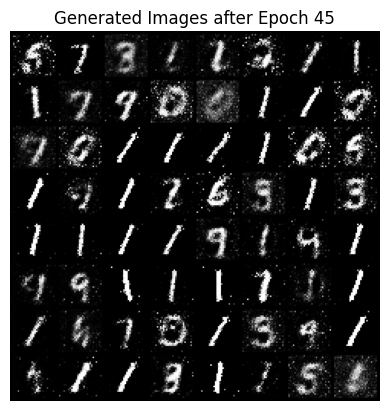

[46/150][0/469]	Loss_D: 0.4597	Loss_G: 3.0621	D(x): 0.8695	D(G(z)): 0.1329/0.1165
[46/150][100/469]	Loss_D: 0.3061	Loss_G: 4.1251	D(x): 0.9220	D(G(z)): 0.1375/0.0469
[46/150][200/469]	Loss_D: 0.3507	Loss_G: 4.2976	D(x): 0.8822	D(G(z)): 0.0663/0.0449
[46/150][300/469]	Loss_D: 0.4427	Loss_G: 3.5491	D(x): 0.9062	D(G(z)): 0.1560/0.0788
[46/150][400/469]	Loss_D: 0.2482	Loss_G: 2.5840	D(x): 0.8939	D(G(z)): 0.0673/0.1176


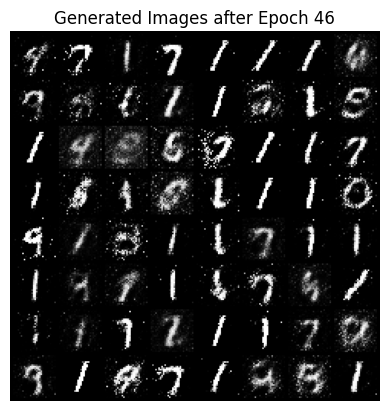

[47/150][0/469]	Loss_D: 0.5077	Loss_G: 2.7723	D(x): 0.8108	D(G(z)): 0.0753/0.1359
[47/150][100/469]	Loss_D: 0.6077	Loss_G: 2.8496	D(x): 0.8398	D(G(z)): 0.1640/0.1254
[47/150][200/469]	Loss_D: 0.3613	Loss_G: 3.5418	D(x): 0.8561	D(G(z)): 0.0701/0.0614
[47/150][300/469]	Loss_D: 0.3054	Loss_G: 3.3033	D(x): 0.8766	D(G(z)): 0.0808/0.0869
[47/150][400/469]	Loss_D: 0.6815	Loss_G: 3.4335	D(x): 0.8809	D(G(z)): 0.2738/0.0844


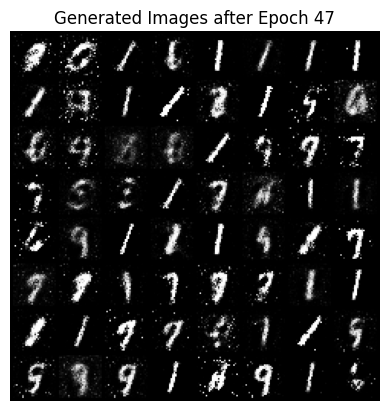

[48/150][0/469]	Loss_D: 0.4332	Loss_G: 3.4387	D(x): 0.8177	D(G(z)): 0.0521/0.0847
[48/150][100/469]	Loss_D: 0.4816	Loss_G: 4.6377	D(x): 0.8618	D(G(z)): 0.0769/0.0467
[48/150][200/469]	Loss_D: 0.4476	Loss_G: 3.3105	D(x): 0.8450	D(G(z)): 0.0850/0.0615
[48/150][300/469]	Loss_D: 0.3331	Loss_G: 2.6035	D(x): 0.9532	D(G(z)): 0.2012/0.1272
[48/150][400/469]	Loss_D: 0.6246	Loss_G: 3.5792	D(x): 0.8844	D(G(z)): 0.2621/0.0804


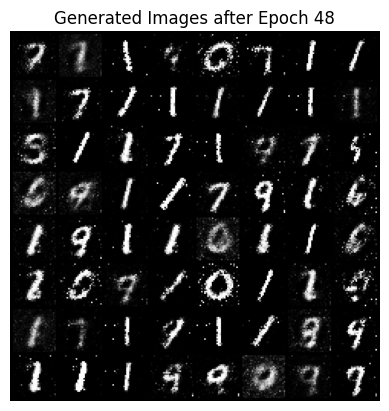

[49/150][0/469]	Loss_D: 0.5049	Loss_G: 3.3351	D(x): 0.8365	D(G(z)): 0.1548/0.0948
[49/150][100/469]	Loss_D: 0.6254	Loss_G: 2.0518	D(x): 0.8614	D(G(z)): 0.2478/0.2241
[49/150][200/469]	Loss_D: 0.5973	Loss_G: 3.2657	D(x): 0.9232	D(G(z)): 0.2873/0.0924
[49/150][300/469]	Loss_D: 0.3946	Loss_G: 3.9685	D(x): 0.8661	D(G(z)): 0.1181/0.0420
[49/150][400/469]	Loss_D: 0.4507	Loss_G: 2.8998	D(x): 0.8566	D(G(z)): 0.1466/0.1226


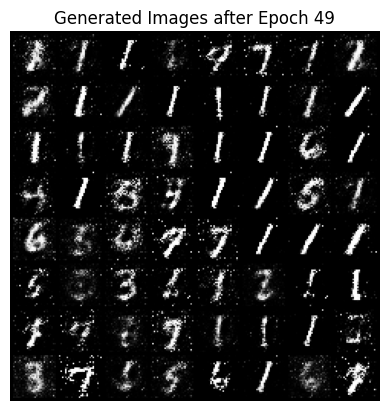

[50/150][0/469]	Loss_D: 0.2565	Loss_G: 4.1575	D(x): 0.9154	D(G(z)): 0.0918/0.0361
[50/150][100/469]	Loss_D: 0.2583	Loss_G: 4.4283	D(x): 0.9041	D(G(z)): 0.0511/0.0295
[50/150][200/469]	Loss_D: 0.4542	Loss_G: 3.2605	D(x): 0.8247	D(G(z)): 0.0786/0.0916
[50/150][300/469]	Loss_D: 0.4014	Loss_G: 3.4998	D(x): 0.8822	D(G(z)): 0.1627/0.0632
[50/150][400/469]	Loss_D: 0.4524	Loss_G: 3.3855	D(x): 0.8595	D(G(z)): 0.1412/0.0723


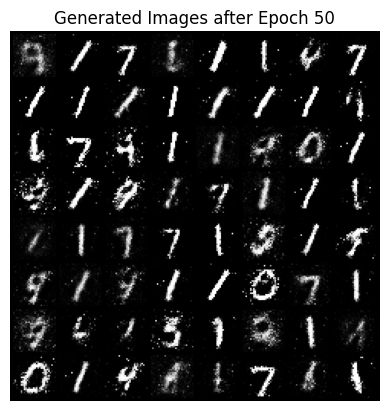

[51/150][0/469]	Loss_D: 0.4040	Loss_G: 3.3666	D(x): 0.8687	D(G(z)): 0.1015/0.0956
[51/150][100/469]	Loss_D: 0.5930	Loss_G: 2.8715	D(x): 0.8185	D(G(z)): 0.1050/0.1298
[51/150][200/469]	Loss_D: 0.3293	Loss_G: 2.8556	D(x): 0.9346	D(G(z)): 0.1616/0.1287
[51/150][300/469]	Loss_D: 0.7820	Loss_G: 2.4130	D(x): 0.9345	D(G(z)): 0.3750/0.1996
[51/150][400/469]	Loss_D: 0.5679	Loss_G: 2.5075	D(x): 0.8223	D(G(z)): 0.1589/0.1399


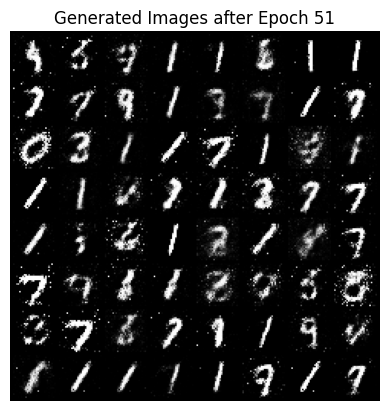

[52/150][0/469]	Loss_D: 0.6311	Loss_G: 3.3402	D(x): 0.7956	D(G(z)): 0.1106/0.0899
[52/150][100/469]	Loss_D: 0.4345	Loss_G: 2.4769	D(x): 0.8553	D(G(z)): 0.1109/0.1611
[52/150][200/469]	Loss_D: 0.5101	Loss_G: 2.1067	D(x): 0.8408	D(G(z)): 0.1913/0.1878
[52/150][300/469]	Loss_D: 0.6217	Loss_G: 3.9352	D(x): 0.7616	D(G(z)): 0.0840/0.0367
[52/150][400/469]	Loss_D: 0.4791	Loss_G: 2.0453	D(x): 0.8783	D(G(z)): 0.1980/0.2074


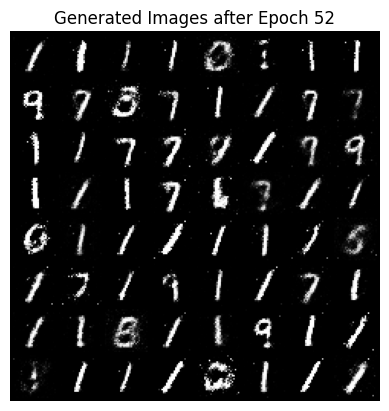

[53/150][0/469]	Loss_D: 0.4978	Loss_G: 2.6323	D(x): 0.8210	D(G(z)): 0.0928/0.1266
[53/150][100/469]	Loss_D: 0.3538	Loss_G: 2.6348	D(x): 0.8572	D(G(z)): 0.0938/0.1440
[53/150][200/469]	Loss_D: 0.5799	Loss_G: 2.2090	D(x): 0.8021	D(G(z)): 0.1703/0.2057
[53/150][300/469]	Loss_D: 0.4565	Loss_G: 2.4839	D(x): 0.8805	D(G(z)): 0.1904/0.1465
[53/150][400/469]	Loss_D: 0.4217	Loss_G: 2.7566	D(x): 0.8911	D(G(z)): 0.1487/0.1383


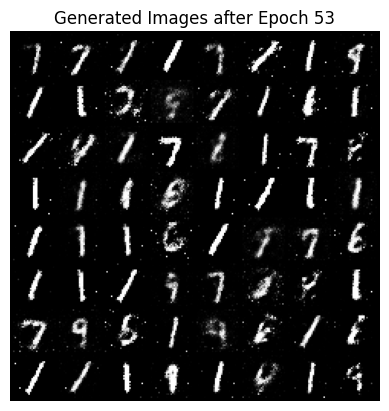

[54/150][0/469]	Loss_D: 0.4974	Loss_G: 2.0450	D(x): 0.8212	D(G(z)): 0.0973/0.2148
[54/150][100/469]	Loss_D: 0.5256	Loss_G: 2.4242	D(x): 0.8810	D(G(z)): 0.1993/0.1546
[54/150][200/469]	Loss_D: 0.5117	Loss_G: 2.0632	D(x): 0.8213	D(G(z)): 0.1564/0.1988
[54/150][300/469]	Loss_D: 0.5314	Loss_G: 4.4113	D(x): 0.7986	D(G(z)): 0.0687/0.0415
[54/150][400/469]	Loss_D: 0.4787	Loss_G: 2.1733	D(x): 0.8435	D(G(z)): 0.1754/0.1697


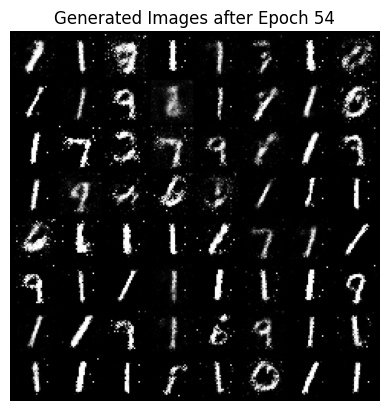

[55/150][0/469]	Loss_D: 0.5246	Loss_G: 2.5779	D(x): 0.8403	D(G(z)): 0.1637/0.1444
[55/150][100/469]	Loss_D: 0.4446	Loss_G: 3.2687	D(x): 0.8818	D(G(z)): 0.1791/0.0815
[55/150][200/469]	Loss_D: 0.2741	Loss_G: 2.8849	D(x): 0.8923	D(G(z)): 0.0758/0.1115
[55/150][300/469]	Loss_D: 0.5028	Loss_G: 2.6799	D(x): 0.8127	D(G(z)): 0.1020/0.1001
[55/150][400/469]	Loss_D: 0.5506	Loss_G: 2.4853	D(x): 0.8533	D(G(z)): 0.1873/0.1338


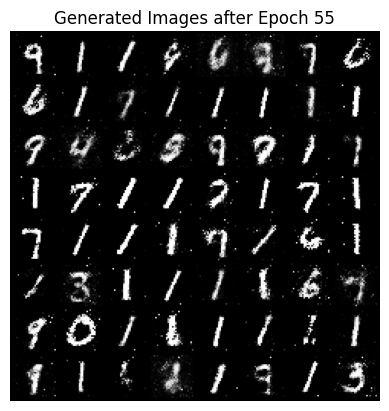

[56/150][0/469]	Loss_D: 0.3658	Loss_G: 2.6857	D(x): 0.8754	D(G(z)): 0.1193/0.1092
[56/150][100/469]	Loss_D: 0.5485	Loss_G: 2.8830	D(x): 0.9078	D(G(z)): 0.2627/0.1126
[56/150][200/469]	Loss_D: 0.6012	Loss_G: 2.0547	D(x): 0.8463	D(G(z)): 0.2397/0.2229
[56/150][300/469]	Loss_D: 0.4386	Loss_G: 3.3126	D(x): 0.8509	D(G(z)): 0.1064/0.0789
[56/150][400/469]	Loss_D: 0.4917	Loss_G: 3.0642	D(x): 0.8546	D(G(z)): 0.1741/0.0995


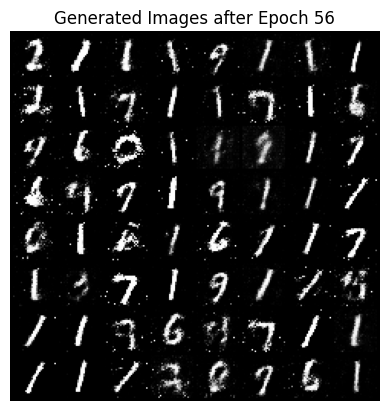

[57/150][0/469]	Loss_D: 0.5136	Loss_G: 2.6915	D(x): 0.7961	D(G(z)): 0.1168/0.1210
[57/150][100/469]	Loss_D: 0.3711	Loss_G: 3.6003	D(x): 0.8477	D(G(z)): 0.0760/0.0498
[57/150][200/469]	Loss_D: 0.5759	Loss_G: 3.1233	D(x): 0.7994	D(G(z)): 0.1367/0.0917
[57/150][300/469]	Loss_D: 0.6063	Loss_G: 2.9605	D(x): 0.8665	D(G(z)): 0.2270/0.1096
[57/150][400/469]	Loss_D: 0.4977	Loss_G: 1.9909	D(x): 0.8518	D(G(z)): 0.1996/0.2193


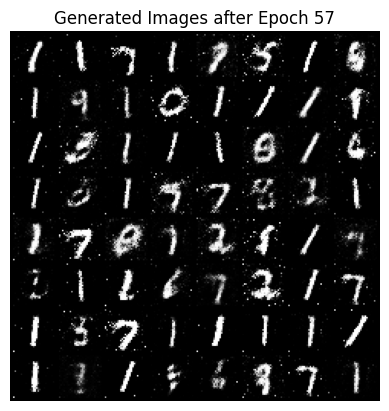

[58/150][0/469]	Loss_D: 0.5548	Loss_G: 2.4208	D(x): 0.8378	D(G(z)): 0.1712/0.1696
[58/150][100/469]	Loss_D: 0.3960	Loss_G: 2.2931	D(x): 0.8744	D(G(z)): 0.1691/0.1439
[58/150][200/469]	Loss_D: 0.5732	Loss_G: 3.3489	D(x): 0.8089	D(G(z)): 0.1185/0.0906
[58/150][300/469]	Loss_D: 0.6545	Loss_G: 2.5183	D(x): 0.7762	D(G(z)): 0.1478/0.1712
[58/150][400/469]	Loss_D: 0.6329	Loss_G: 3.0112	D(x): 0.7834	D(G(z)): 0.1498/0.1259


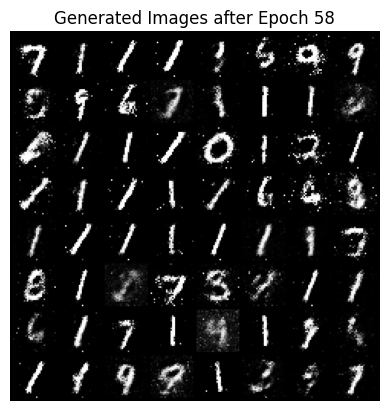

[59/150][0/469]	Loss_D: 0.5810	Loss_G: 2.4446	D(x): 0.9136	D(G(z)): 0.2961/0.1482
[59/150][100/469]	Loss_D: 0.7260	Loss_G: 2.4631	D(x): 0.8447	D(G(z)): 0.2737/0.1548
[59/150][200/469]	Loss_D: 0.8810	Loss_G: 2.7228	D(x): 0.7283	D(G(z)): 0.0880/0.1280
[59/150][300/469]	Loss_D: 0.8025	Loss_G: 3.3263	D(x): 0.7482	D(G(z)): 0.1797/0.1171
[59/150][400/469]	Loss_D: 0.6387	Loss_G: 1.9207	D(x): 0.7671	D(G(z)): 0.1531/0.2249


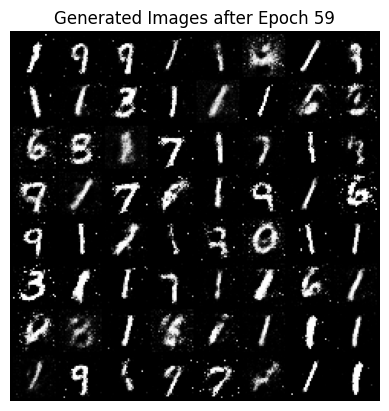

[60/150][0/469]	Loss_D: 0.6463	Loss_G: 1.6346	D(x): 0.7995	D(G(z)): 0.1967/0.2919
[60/150][100/469]	Loss_D: 0.5476	Loss_G: 2.1600	D(x): 0.8038	D(G(z)): 0.1608/0.1723
[60/150][200/469]	Loss_D: 0.5540	Loss_G: 3.5496	D(x): 0.8247	D(G(z)): 0.1653/0.0687
[60/150][300/469]	Loss_D: 0.5583	Loss_G: 2.8318	D(x): 0.8147	D(G(z)): 0.1766/0.0980
[60/150][400/469]	Loss_D: 0.4951	Loss_G: 2.5272	D(x): 0.8430	D(G(z)): 0.1513/0.1609


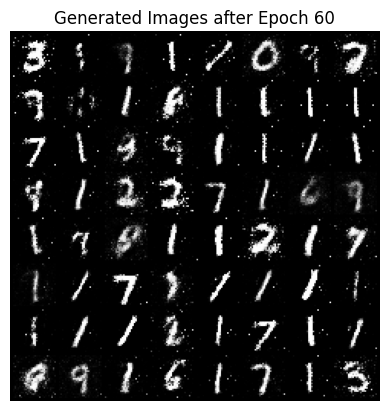

[61/150][0/469]	Loss_D: 0.4551	Loss_G: 2.8170	D(x): 0.8920	D(G(z)): 0.2076/0.1197
[61/150][100/469]	Loss_D: 0.6522	Loss_G: 2.0874	D(x): 0.7979	D(G(z)): 0.1749/0.2154
[61/150][200/469]	Loss_D: 0.5574	Loss_G: 2.0215	D(x): 0.7892	D(G(z)): 0.1469/0.2011
[61/150][300/469]	Loss_D: 0.5595	Loss_G: 2.4347	D(x): 0.8125	D(G(z)): 0.1483/0.1750
[61/150][400/469]	Loss_D: 0.6445	Loss_G: 2.9150	D(x): 0.7581	D(G(z)): 0.1227/0.1193


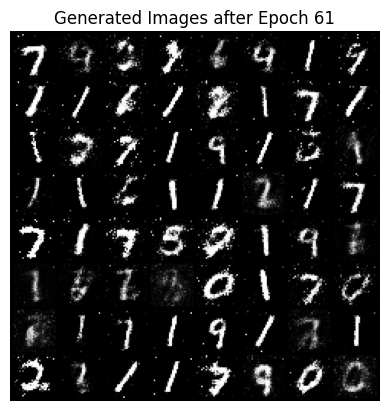

[62/150][0/469]	Loss_D: 0.7266	Loss_G: 3.1848	D(x): 0.8176	D(G(z)): 0.1982/0.1223
[62/150][100/469]	Loss_D: 0.5865	Loss_G: 2.2647	D(x): 0.7595	D(G(z)): 0.1315/0.1555
[62/150][200/469]	Loss_D: 0.7417	Loss_G: 1.8347	D(x): 0.8308	D(G(z)): 0.2987/0.2206
[62/150][300/469]	Loss_D: 0.6879	Loss_G: 2.6572	D(x): 0.7933	D(G(z)): 0.1759/0.1256
[62/150][400/469]	Loss_D: 0.3688	Loss_G: 2.5301	D(x): 0.8760	D(G(z)): 0.1486/0.1435


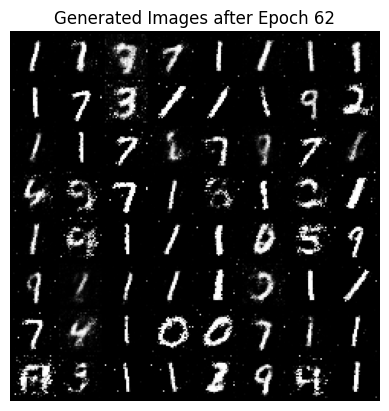

[63/150][0/469]	Loss_D: 0.5878	Loss_G: 1.9507	D(x): 0.7925	D(G(z)): 0.1973/0.1988
[63/150][100/469]	Loss_D: 0.5083	Loss_G: 2.9708	D(x): 0.8005	D(G(z)): 0.1198/0.1064
[63/150][200/469]	Loss_D: 0.7523	Loss_G: 1.9546	D(x): 0.6944	D(G(z)): 0.1081/0.2091
[63/150][300/469]	Loss_D: 0.6635	Loss_G: 2.9750	D(x): 0.7211	D(G(z)): 0.0889/0.1079
[63/150][400/469]	Loss_D: 0.5332	Loss_G: 2.7652	D(x): 0.8254	D(G(z)): 0.1516/0.1045


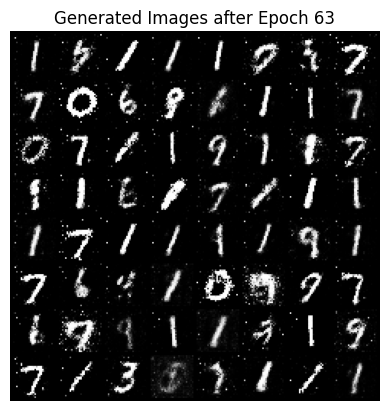

[64/150][0/469]	Loss_D: 0.5275	Loss_G: 3.1435	D(x): 0.8483	D(G(z)): 0.1892/0.0770
[64/150][100/469]	Loss_D: 0.5001	Loss_G: 1.8321	D(x): 0.8593	D(G(z)): 0.1988/0.2393
[64/150][200/469]	Loss_D: 0.5379	Loss_G: 2.4957	D(x): 0.8357	D(G(z)): 0.1854/0.1428
[64/150][300/469]	Loss_D: 0.3928	Loss_G: 2.7245	D(x): 0.8943	D(G(z)): 0.1776/0.1485
[64/150][400/469]	Loss_D: 0.6756	Loss_G: 2.0029	D(x): 0.8341	D(G(z)): 0.2575/0.2100


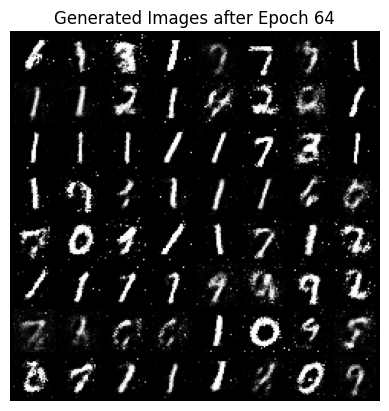

[65/150][0/469]	Loss_D: 0.6402	Loss_G: 2.1849	D(x): 0.8022	D(G(z)): 0.2057/0.1695
[65/150][100/469]	Loss_D: 0.6597	Loss_G: 2.1982	D(x): 0.7984	D(G(z)): 0.1954/0.1815
[65/150][200/469]	Loss_D: 0.5325	Loss_G: 2.3482	D(x): 0.7932	D(G(z)): 0.1419/0.1493
[65/150][300/469]	Loss_D: 0.6618	Loss_G: 2.1584	D(x): 0.8348	D(G(z)): 0.2027/0.2223
[65/150][400/469]	Loss_D: 0.6831	Loss_G: 3.1402	D(x): 0.8082	D(G(z)): 0.1900/0.1177


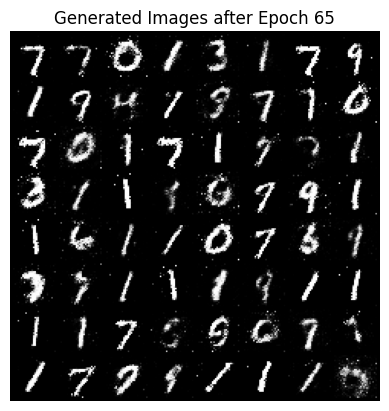

[66/150][0/469]	Loss_D: 0.5005	Loss_G: 2.2959	D(x): 0.8189	D(G(z)): 0.1683/0.1494
[66/150][100/469]	Loss_D: 0.6207	Loss_G: 2.1932	D(x): 0.8852	D(G(z)): 0.3033/0.1914
[66/150][200/469]	Loss_D: 0.6401	Loss_G: 2.0611	D(x): 0.8148	D(G(z)): 0.2523/0.2076
[66/150][300/469]	Loss_D: 0.6836	Loss_G: 2.1581	D(x): 0.8825	D(G(z)): 0.2827/0.1942
[66/150][400/469]	Loss_D: 0.7064	Loss_G: 1.9073	D(x): 0.8662	D(G(z)): 0.3123/0.2246


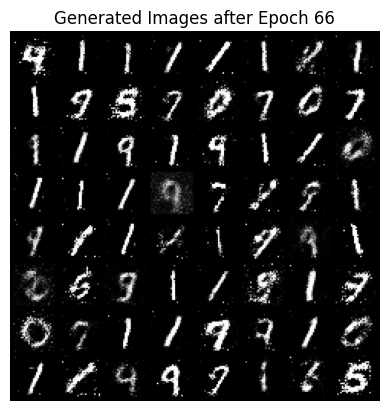

[67/150][0/469]	Loss_D: 0.5506	Loss_G: 2.5304	D(x): 0.8137	D(G(z)): 0.1441/0.1371
[67/150][100/469]	Loss_D: 0.6707	Loss_G: 1.5965	D(x): 0.8769	D(G(z)): 0.3377/0.2812
[67/150][200/469]	Loss_D: 0.7112	Loss_G: 2.7447	D(x): 0.7025	D(G(z)): 0.0843/0.1139
[67/150][300/469]	Loss_D: 0.6575	Loss_G: 1.9528	D(x): 0.7729	D(G(z)): 0.2045/0.2114
[67/150][400/469]	Loss_D: 0.5666	Loss_G: 1.6694	D(x): 0.8011	D(G(z)): 0.1839/0.2509


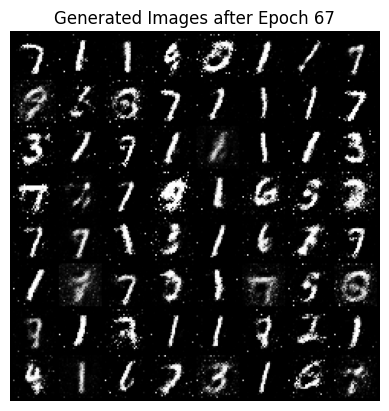

[68/150][0/469]	Loss_D: 0.7682	Loss_G: 2.4979	D(x): 0.7152	D(G(z)): 0.1922/0.1238
[68/150][100/469]	Loss_D: 0.8982	Loss_G: 1.8228	D(x): 0.7733	D(G(z)): 0.2520/0.2728
[68/150][200/469]	Loss_D: 0.6365	Loss_G: 2.1765	D(x): 0.8058	D(G(z)): 0.1983/0.1908
[68/150][300/469]	Loss_D: 0.8331	Loss_G: 2.7217	D(x): 0.6963	D(G(z)): 0.1662/0.1278
[68/150][400/469]	Loss_D: 0.7194	Loss_G: 2.1639	D(x): 0.8490	D(G(z)): 0.2676/0.2009


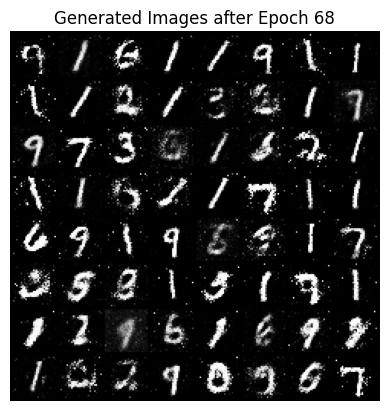

[69/150][0/469]	Loss_D: 0.3630	Loss_G: 2.9531	D(x): 0.8790	D(G(z)): 0.1521/0.0968
[69/150][100/469]	Loss_D: 0.8560	Loss_G: 1.8022	D(x): 0.7333	D(G(z)): 0.2364/0.2381
[69/150][200/469]	Loss_D: 0.6936	Loss_G: 2.2571	D(x): 0.7948	D(G(z)): 0.1895/0.1500
[69/150][300/469]	Loss_D: 0.6980	Loss_G: 1.6877	D(x): 0.8448	D(G(z)): 0.2845/0.2659
[69/150][400/469]	Loss_D: 0.4847	Loss_G: 2.2042	D(x): 0.8421	D(G(z)): 0.1696/0.1782


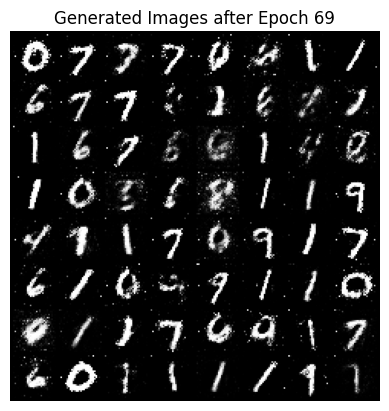

[70/150][0/469]	Loss_D: 0.7307	Loss_G: 1.9752	D(x): 0.9028	D(G(z)): 0.3860/0.2058
[70/150][100/469]	Loss_D: 0.6009	Loss_G: 2.5541	D(x): 0.7649	D(G(z)): 0.1347/0.1358
[70/150][200/469]	Loss_D: 0.6056	Loss_G: 2.9240	D(x): 0.7865	D(G(z)): 0.1232/0.0955
[70/150][300/469]	Loss_D: 0.5042	Loss_G: 3.3171	D(x): 0.7799	D(G(z)): 0.1056/0.0774
[70/150][400/469]	Loss_D: 0.8202	Loss_G: 2.3863	D(x): 0.7154	D(G(z)): 0.1529/0.1752


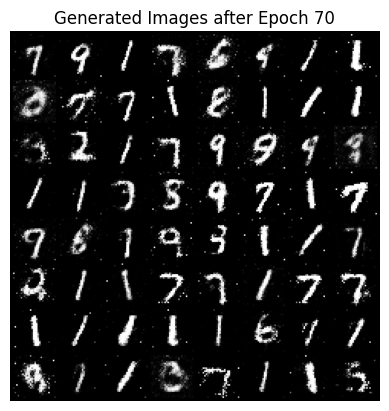

[71/150][0/469]	Loss_D: 0.6332	Loss_G: 2.6634	D(x): 0.8896	D(G(z)): 0.3020/0.1201
[71/150][100/469]	Loss_D: 0.7489	Loss_G: 1.6269	D(x): 0.7953	D(G(z)): 0.2749/0.2706
[71/150][200/469]	Loss_D: 0.5629	Loss_G: 2.8555	D(x): 0.8083	D(G(z)): 0.1846/0.1109
[71/150][300/469]	Loss_D: 0.5783	Loss_G: 2.2430	D(x): 0.7665	D(G(z)): 0.1602/0.1591
[71/150][400/469]	Loss_D: 0.6898	Loss_G: 2.0123	D(x): 0.7715	D(G(z)): 0.1957/0.1983


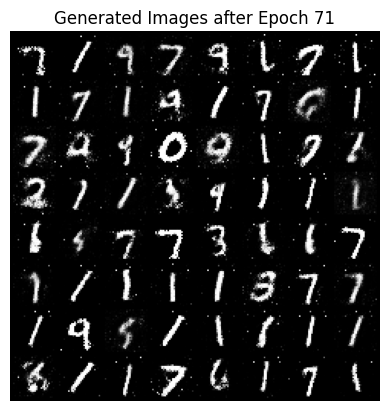

[72/150][0/469]	Loss_D: 0.7230	Loss_G: 2.6476	D(x): 0.7038	D(G(z)): 0.0980/0.1128
[72/150][100/469]	Loss_D: 0.5597	Loss_G: 2.3109	D(x): 0.8002	D(G(z)): 0.1824/0.1479
[72/150][200/469]	Loss_D: 0.8323	Loss_G: 2.2063	D(x): 0.7430	D(G(z)): 0.2197/0.2049
[72/150][300/469]	Loss_D: 0.5482	Loss_G: 2.7365	D(x): 0.8047	D(G(z)): 0.1474/0.1293
[72/150][400/469]	Loss_D: 0.5841	Loss_G: 2.1818	D(x): 0.7960	D(G(z)): 0.1592/0.1834


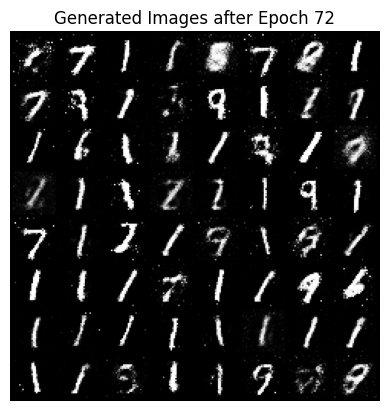

[73/150][0/469]	Loss_D: 0.5954	Loss_G: 2.8630	D(x): 0.8389	D(G(z)): 0.1969/0.1139
[73/150][100/469]	Loss_D: 0.8346	Loss_G: 2.0441	D(x): 0.7102	D(G(z)): 0.1999/0.2148
[73/150][200/469]	Loss_D: 0.6654	Loss_G: 2.0232	D(x): 0.7322	D(G(z)): 0.1762/0.1846
[73/150][300/469]	Loss_D: 0.6998	Loss_G: 2.1764	D(x): 0.7874	D(G(z)): 0.2025/0.1893
[73/150][400/469]	Loss_D: 0.7447	Loss_G: 2.3594	D(x): 0.7217	D(G(z)): 0.1436/0.1536


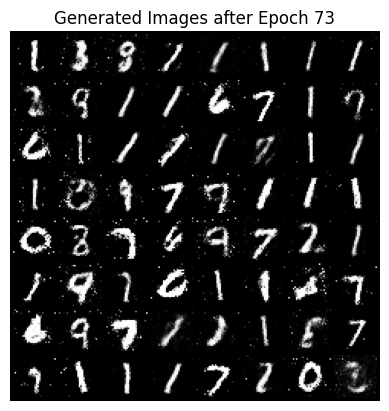

[74/150][0/469]	Loss_D: 0.5310	Loss_G: 2.3454	D(x): 0.8102	D(G(z)): 0.1577/0.1505
[74/150][100/469]	Loss_D: 0.6696	Loss_G: 2.1901	D(x): 0.8728	D(G(z)): 0.3061/0.1951
[74/150][200/469]	Loss_D: 0.8060	Loss_G: 2.0716	D(x): 0.7205	D(G(z)): 0.2104/0.2117
[74/150][300/469]	Loss_D: 0.7293	Loss_G: 1.9311	D(x): 0.7823	D(G(z)): 0.2165/0.2397
[74/150][400/469]	Loss_D: 0.6784	Loss_G: 2.1264	D(x): 0.8437	D(G(z)): 0.2852/0.1947


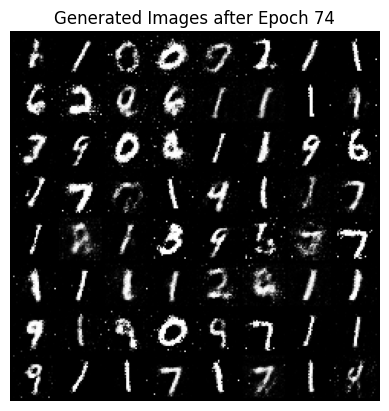

[75/150][0/469]	Loss_D: 0.6197	Loss_G: 2.1695	D(x): 0.7754	D(G(z)): 0.1718/0.1788
[75/150][100/469]	Loss_D: 0.7198	Loss_G: 2.4156	D(x): 0.7764	D(G(z)): 0.2310/0.1670
[75/150][200/469]	Loss_D: 1.0073	Loss_G: 2.0475	D(x): 0.6283	D(G(z)): 0.1543/0.2150
[75/150][300/469]	Loss_D: 0.6557	Loss_G: 2.1397	D(x): 0.7686	D(G(z)): 0.1598/0.1927
[75/150][400/469]	Loss_D: 0.6332	Loss_G: 2.7628	D(x): 0.8452	D(G(z)): 0.2248/0.1270


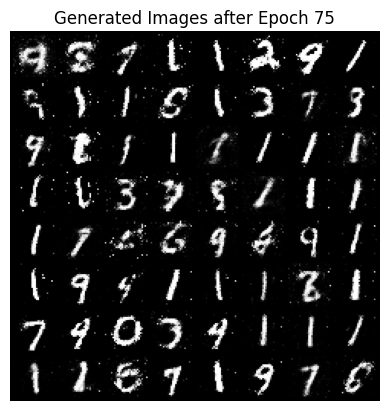

[76/150][0/469]	Loss_D: 0.8468	Loss_G: 1.8604	D(x): 0.7294	D(G(z)): 0.2226/0.2443
[76/150][100/469]	Loss_D: 0.8469	Loss_G: 1.8167	D(x): 0.7589	D(G(z)): 0.2603/0.2476
[76/150][200/469]	Loss_D: 0.6496	Loss_G: 1.7945	D(x): 0.7418	D(G(z)): 0.1783/0.2339
[76/150][300/469]	Loss_D: 0.6281	Loss_G: 2.1129	D(x): 0.8123	D(G(z)): 0.2383/0.1837
[76/150][400/469]	Loss_D: 0.6315	Loss_G: 2.2100	D(x): 0.7593	D(G(z)): 0.1668/0.1811


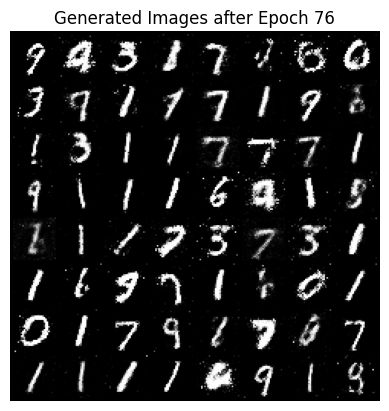

[77/150][0/469]	Loss_D: 0.5537	Loss_G: 2.5063	D(x): 0.7691	D(G(z)): 0.1466/0.1144
[77/150][100/469]	Loss_D: 0.6624	Loss_G: 2.3358	D(x): 0.8171	D(G(z)): 0.2172/0.1607
[77/150][200/469]	Loss_D: 0.7823	Loss_G: 1.6945	D(x): 0.7457	D(G(z)): 0.2115/0.2505
[77/150][300/469]	Loss_D: 0.6505	Loss_G: 1.8596	D(x): 0.7657	D(G(z)): 0.1948/0.2287
[77/150][400/469]	Loss_D: 0.8409	Loss_G: 2.0116	D(x): 0.6816	D(G(z)): 0.1334/0.2129


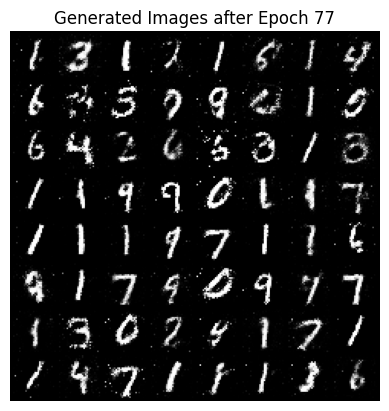

[78/150][0/469]	Loss_D: 0.4626	Loss_G: 2.4028	D(x): 0.8123	D(G(z)): 0.1382/0.1582
[78/150][100/469]	Loss_D: 0.8199	Loss_G: 2.0200	D(x): 0.7784	D(G(z)): 0.3144/0.1975
[78/150][200/469]	Loss_D: 0.4809	Loss_G: 1.7282	D(x): 0.8832	D(G(z)): 0.2396/0.2452
[78/150][300/469]	Loss_D: 0.5671	Loss_G: 2.2548	D(x): 0.8117	D(G(z)): 0.1948/0.1646
[78/150][400/469]	Loss_D: 0.7965	Loss_G: 2.1659	D(x): 0.8328	D(G(z)): 0.3004/0.2115


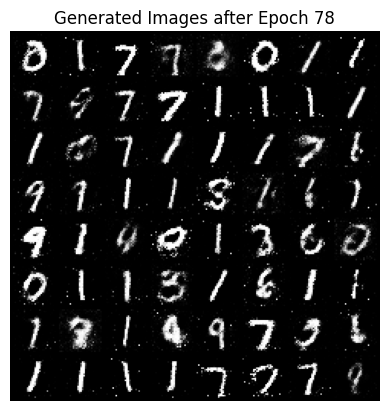

[79/150][0/469]	Loss_D: 0.5330	Loss_G: 2.6266	D(x): 0.8007	D(G(z)): 0.1573/0.1345
[79/150][100/469]	Loss_D: 0.7054	Loss_G: 1.8399	D(x): 0.7437	D(G(z)): 0.2047/0.2293
[79/150][200/469]	Loss_D: 0.8377	Loss_G: 2.4570	D(x): 0.7695	D(G(z)): 0.2708/0.1590
[79/150][300/469]	Loss_D: 0.5777	Loss_G: 2.3020	D(x): 0.7948	D(G(z)): 0.1416/0.1658
[79/150][400/469]	Loss_D: 0.5904	Loss_G: 2.5778	D(x): 0.8179	D(G(z)): 0.1949/0.1530


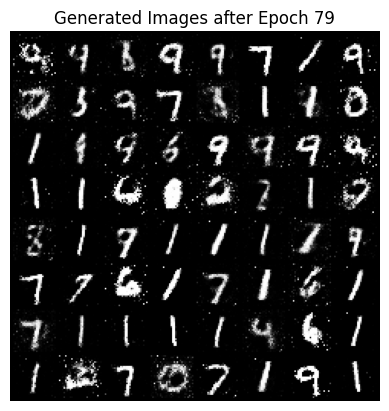

[80/150][0/469]	Loss_D: 0.7422	Loss_G: 2.2223	D(x): 0.7338	D(G(z)): 0.1776/0.1815
[80/150][100/469]	Loss_D: 0.6540	Loss_G: 1.9716	D(x): 0.7550	D(G(z)): 0.1897/0.1902
[80/150][200/469]	Loss_D: 0.7753	Loss_G: 1.8843	D(x): 0.8480	D(G(z)): 0.3356/0.2165
[80/150][300/469]	Loss_D: 0.7726	Loss_G: 2.1559	D(x): 0.7809	D(G(z)): 0.2458/0.1750
[80/150][400/469]	Loss_D: 0.8552	Loss_G: 2.2504	D(x): 0.7005	D(G(z)): 0.1995/0.1753


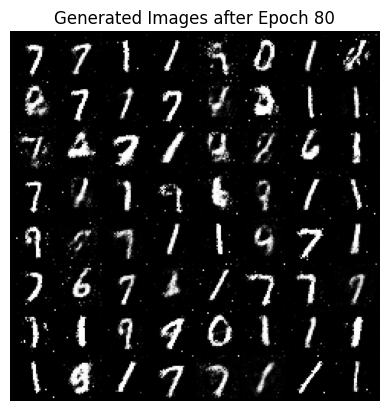

[81/150][0/469]	Loss_D: 0.6935	Loss_G: 2.1957	D(x): 0.7666	D(G(z)): 0.1907/0.1740
[81/150][100/469]	Loss_D: 0.5135	Loss_G: 2.7555	D(x): 0.8327	D(G(z)): 0.1876/0.1145
[81/150][200/469]	Loss_D: 0.8786	Loss_G: 1.6832	D(x): 0.6793	D(G(z)): 0.1980/0.2585
[81/150][300/469]	Loss_D: 0.5801	Loss_G: 2.3498	D(x): 0.7605	D(G(z)): 0.1143/0.1462
[81/150][400/469]	Loss_D: 0.6990	Loss_G: 2.1556	D(x): 0.8576	D(G(z)): 0.3155/0.1754


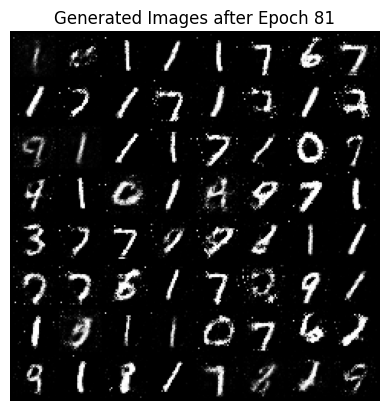

[82/150][0/469]	Loss_D: 0.7140	Loss_G: 2.1554	D(x): 0.7419	D(G(z)): 0.1648/0.1687
[82/150][100/469]	Loss_D: 0.6847	Loss_G: 1.8490	D(x): 0.7446	D(G(z)): 0.1988/0.2228
[82/150][200/469]	Loss_D: 0.9182	Loss_G: 1.7311	D(x): 0.8206	D(G(z)): 0.3784/0.2599
[82/150][300/469]	Loss_D: 0.6714	Loss_G: 2.1575	D(x): 0.8106	D(G(z)): 0.2406/0.1781
[82/150][400/469]	Loss_D: 0.6459	Loss_G: 2.1155	D(x): 0.7864	D(G(z)): 0.1927/0.1814


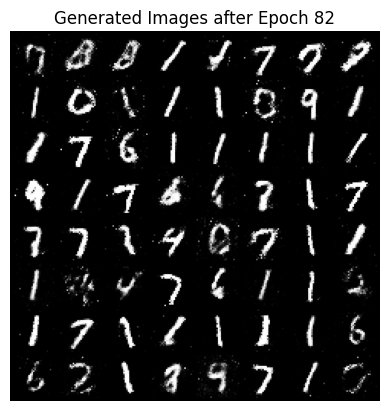

[83/150][0/469]	Loss_D: 0.7056	Loss_G: 1.9942	D(x): 0.7884	D(G(z)): 0.2644/0.2075
[83/150][100/469]	Loss_D: 0.8286	Loss_G: 1.9383	D(x): 0.6731	D(G(z)): 0.1783/0.2042
[83/150][200/469]	Loss_D: 0.8100	Loss_G: 1.6004	D(x): 0.7184	D(G(z)): 0.2013/0.2973
[83/150][300/469]	Loss_D: 0.5767	Loss_G: 2.8218	D(x): 0.8222	D(G(z)): 0.2252/0.1064
[83/150][400/469]	Loss_D: 0.6370	Loss_G: 2.4620	D(x): 0.8268	D(G(z)): 0.2607/0.1373


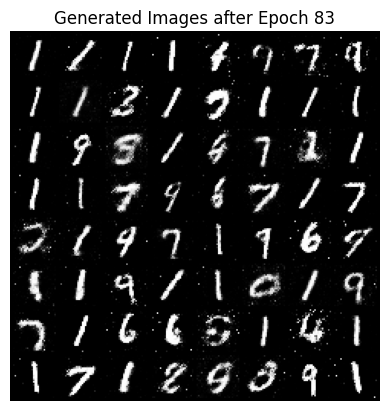

[84/150][0/469]	Loss_D: 0.7800	Loss_G: 1.9010	D(x): 0.8264	D(G(z)): 0.3090/0.2420
[84/150][100/469]	Loss_D: 0.6807	Loss_G: 1.7398	D(x): 0.8349	D(G(z)): 0.2886/0.2608
[84/150][200/469]	Loss_D: 0.7260	Loss_G: 1.4950	D(x): 0.7922	D(G(z)): 0.2502/0.3153
[84/150][300/469]	Loss_D: 0.7635	Loss_G: 2.1165	D(x): 0.7954	D(G(z)): 0.2401/0.2041
[84/150][400/469]	Loss_D: 0.6402	Loss_G: 1.7980	D(x): 0.8310	D(G(z)): 0.2384/0.2511


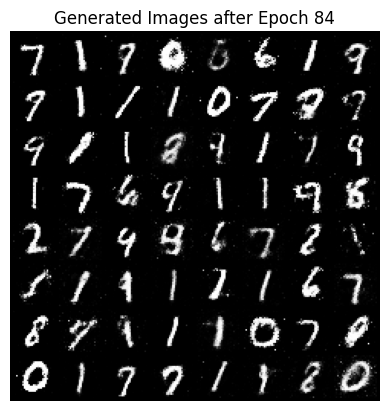

[85/150][0/469]	Loss_D: 0.7956	Loss_G: 1.6960	D(x): 0.7774	D(G(z)): 0.2803/0.2809
[85/150][100/469]	Loss_D: 0.7287	Loss_G: 1.8179	D(x): 0.7702	D(G(z)): 0.2596/0.2402
[85/150][200/469]	Loss_D: 0.5924	Loss_G: 2.2906	D(x): 0.8110	D(G(z)): 0.2031/0.1747
[85/150][300/469]	Loss_D: 0.6986	Loss_G: 1.9445	D(x): 0.7735	D(G(z)): 0.2261/0.2076
[85/150][400/469]	Loss_D: 0.9127	Loss_G: 1.2594	D(x): 0.8149	D(G(z)): 0.3536/0.3647


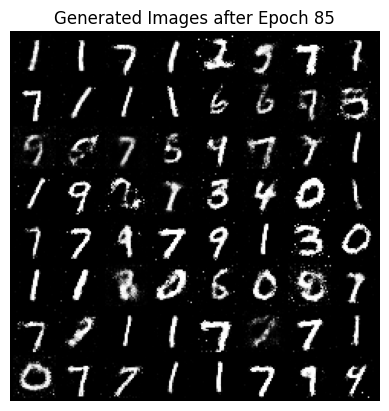

[86/150][0/469]	Loss_D: 0.5911	Loss_G: 2.2996	D(x): 0.7989	D(G(z)): 0.2038/0.1422
[86/150][100/469]	Loss_D: 0.8459	Loss_G: 1.8095	D(x): 0.8006	D(G(z)): 0.3510/0.2411
[86/150][200/469]	Loss_D: 0.7860	Loss_G: 1.8229	D(x): 0.7915	D(G(z)): 0.3299/0.2141
[86/150][300/469]	Loss_D: 0.9932	Loss_G: 2.1745	D(x): 0.6259	D(G(z)): 0.1198/0.1852
[86/150][400/469]	Loss_D: 0.7486	Loss_G: 1.9225	D(x): 0.7976	D(G(z)): 0.2931/0.2275


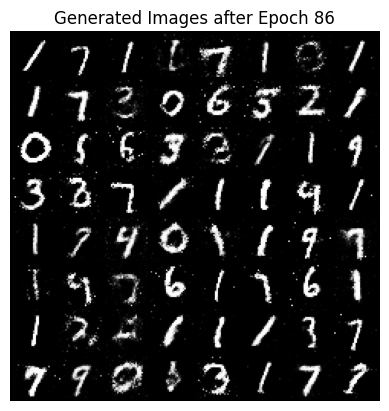

[87/150][0/469]	Loss_D: 0.7140	Loss_G: 2.5681	D(x): 0.7460	D(G(z)): 0.2155/0.1386
[87/150][100/469]	Loss_D: 0.8069	Loss_G: 2.0825	D(x): 0.7799	D(G(z)): 0.2835/0.2044
[87/150][200/469]	Loss_D: 0.8085	Loss_G: 1.7468	D(x): 0.7765	D(G(z)): 0.3173/0.2602
[87/150][300/469]	Loss_D: 0.6186	Loss_G: 1.8607	D(x): 0.7850	D(G(z)): 0.1973/0.2159
[87/150][400/469]	Loss_D: 0.6890	Loss_G: 2.0276	D(x): 0.7110	D(G(z)): 0.1624/0.1827


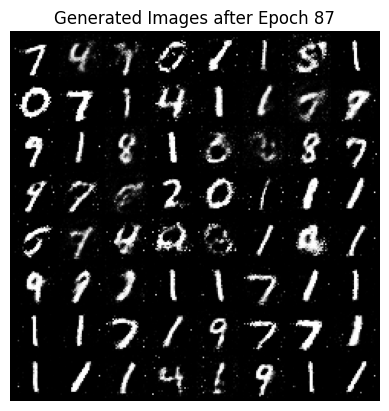

[88/150][0/469]	Loss_D: 0.8929	Loss_G: 2.2876	D(x): 0.8636	D(G(z)): 0.4145/0.1732
[88/150][100/469]	Loss_D: 0.7633	Loss_G: 1.7205	D(x): 0.8086	D(G(z)): 0.2775/0.2416
[88/150][200/469]	Loss_D: 0.6562	Loss_G: 2.4112	D(x): 0.7272	D(G(z)): 0.1353/0.1280
[88/150][300/469]	Loss_D: 0.7012	Loss_G: 1.7797	D(x): 0.7708	D(G(z)): 0.2621/0.2297
[88/150][400/469]	Loss_D: 0.7282	Loss_G: 1.9866	D(x): 0.7835	D(G(z)): 0.2689/0.2034


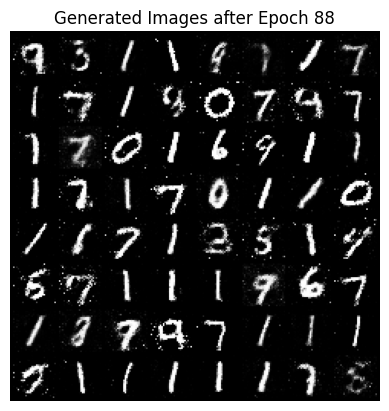

[89/150][0/469]	Loss_D: 0.8758	Loss_G: 1.6209	D(x): 0.7453	D(G(z)): 0.2844/0.2773
[89/150][100/469]	Loss_D: 0.7369	Loss_G: 2.3564	D(x): 0.7737	D(G(z)): 0.2346/0.1619
[89/150][200/469]	Loss_D: 0.6700	Loss_G: 1.5956	D(x): 0.7303	D(G(z)): 0.1683/0.2960
[89/150][300/469]	Loss_D: 0.7181	Loss_G: 1.9558	D(x): 0.8247	D(G(z)): 0.3118/0.2185
[89/150][400/469]	Loss_D: 0.6875	Loss_G: 1.8280	D(x): 0.7964	D(G(z)): 0.2610/0.2107


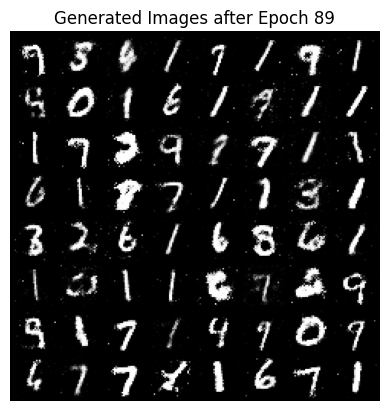

[90/150][0/469]	Loss_D: 0.5986	Loss_G: 2.2392	D(x): 0.7816	D(G(z)): 0.2070/0.1609
[90/150][100/469]	Loss_D: 0.8610	Loss_G: 1.6542	D(x): 0.7572	D(G(z)): 0.2707/0.2751
[90/150][200/469]	Loss_D: 0.7375	Loss_G: 2.3319	D(x): 0.8292	D(G(z)): 0.2812/0.1805
[90/150][300/469]	Loss_D: 0.7430	Loss_G: 2.0516	D(x): 0.7510	D(G(z)): 0.2514/0.1960
[90/150][400/469]	Loss_D: 0.8017	Loss_G: 1.5068	D(x): 0.7823	D(G(z)): 0.2989/0.2913


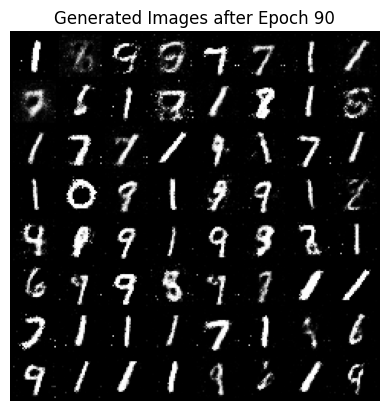

[91/150][0/469]	Loss_D: 0.7520	Loss_G: 1.8778	D(x): 0.7563	D(G(z)): 0.2024/0.2466
[91/150][100/469]	Loss_D: 0.7306	Loss_G: 2.0784	D(x): 0.8119	D(G(z)): 0.2976/0.1942
[91/150][200/469]	Loss_D: 0.6871	Loss_G: 1.7869	D(x): 0.7735	D(G(z)): 0.2465/0.2453
[91/150][300/469]	Loss_D: 0.7124	Loss_G: 1.6230	D(x): 0.8052	D(G(z)): 0.2943/0.2632
[91/150][400/469]	Loss_D: 0.8863	Loss_G: 1.4847	D(x): 0.7640	D(G(z)): 0.2997/0.3110


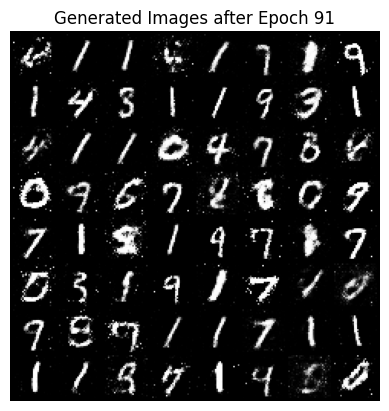

[92/150][0/469]	Loss_D: 0.7167	Loss_G: 1.9095	D(x): 0.7470	D(G(z)): 0.2440/0.2054
[92/150][100/469]	Loss_D: 0.8655	Loss_G: 2.3772	D(x): 0.6292	D(G(z)): 0.1247/0.1526
[92/150][200/469]	Loss_D: 0.7934	Loss_G: 1.8794	D(x): 0.8533	D(G(z)): 0.3568/0.2311
[92/150][300/469]	Loss_D: 0.6979	Loss_G: 2.2928	D(x): 0.7627	D(G(z)): 0.2374/0.1604
[92/150][400/469]	Loss_D: 0.8151	Loss_G: 1.9689	D(x): 0.6968	D(G(z)): 0.2103/0.2102


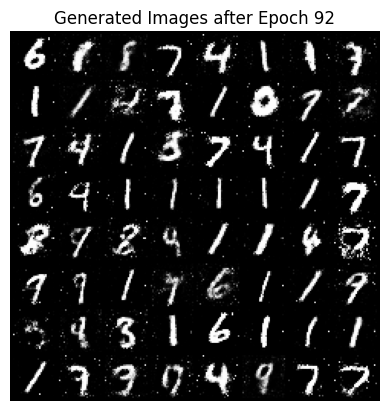

[93/150][0/469]	Loss_D: 0.6046	Loss_G: 1.6759	D(x): 0.7922	D(G(z)): 0.2283/0.2475
[93/150][100/469]	Loss_D: 0.9074	Loss_G: 1.8037	D(x): 0.8028	D(G(z)): 0.3845/0.2303
[93/150][200/469]	Loss_D: 0.7213	Loss_G: 1.9024	D(x): 0.8048	D(G(z)): 0.2887/0.2302
[93/150][300/469]	Loss_D: 0.6704	Loss_G: 2.1041	D(x): 0.7359	D(G(z)): 0.1916/0.1969
[93/150][400/469]	Loss_D: 0.7705	Loss_G: 1.6968	D(x): 0.7804	D(G(z)): 0.3028/0.2692


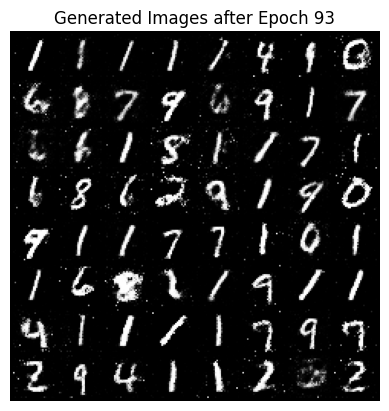

[94/150][0/469]	Loss_D: 0.6103	Loss_G: 2.2217	D(x): 0.8202	D(G(z)): 0.2467/0.1693
[94/150][100/469]	Loss_D: 0.6594	Loss_G: 1.8885	D(x): 0.8045	D(G(z)): 0.2530/0.2444
[94/150][200/469]	Loss_D: 0.6470	Loss_G: 2.4118	D(x): 0.7890	D(G(z)): 0.2101/0.1483
[94/150][300/469]	Loss_D: 0.9308	Loss_G: 2.4413	D(x): 0.6229	D(G(z)): 0.1149/0.1468
[94/150][400/469]	Loss_D: 0.8856	Loss_G: 1.6687	D(x): 0.8063	D(G(z)): 0.3752/0.2477


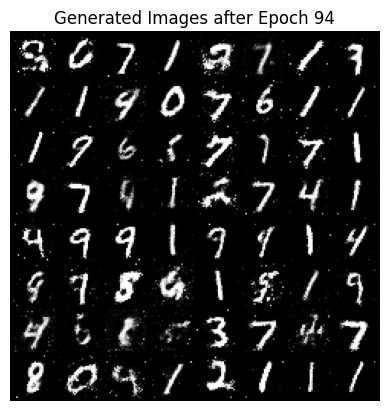

[95/150][0/469]	Loss_D: 0.8490	Loss_G: 1.3500	D(x): 0.8024	D(G(z)): 0.3373/0.3273
[95/150][100/469]	Loss_D: 0.6373	Loss_G: 1.9636	D(x): 0.7353	D(G(z)): 0.1444/0.2210
[95/150][200/469]	Loss_D: 0.7762	Loss_G: 1.8015	D(x): 0.7350	D(G(z)): 0.2198/0.2398
[95/150][300/469]	Loss_D: 0.9854	Loss_G: 1.8938	D(x): 0.6331	D(G(z)): 0.1855/0.2173
[95/150][400/469]	Loss_D: 0.7216	Loss_G: 2.3700	D(x): 0.7589	D(G(z)): 0.2061/0.1512


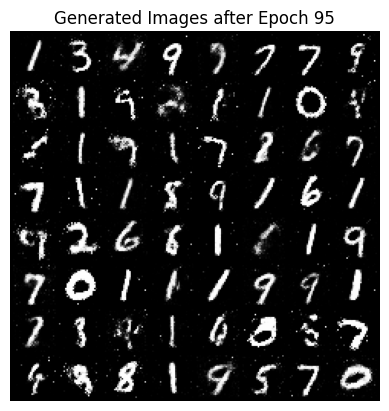

[96/150][0/469]	Loss_D: 0.7387	Loss_G: 2.3280	D(x): 0.7998	D(G(z)): 0.2569/0.1733
[96/150][100/469]	Loss_D: 0.7567	Loss_G: 1.2140	D(x): 0.8092	D(G(z)): 0.3063/0.3686
[96/150][200/469]	Loss_D: 0.8045	Loss_G: 2.1393	D(x): 0.7141	D(G(z)): 0.2620/0.1649
[96/150][300/469]	Loss_D: 0.8435	Loss_G: 1.7778	D(x): 0.6931	D(G(z)): 0.2289/0.2256
[96/150][400/469]	Loss_D: 0.7314	Loss_G: 2.0340	D(x): 0.7601	D(G(z)): 0.2652/0.1924


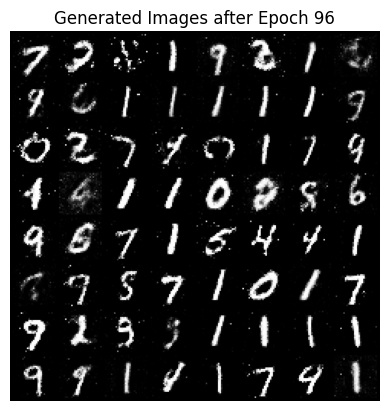

[97/150][0/469]	Loss_D: 0.6731	Loss_G: 1.8453	D(x): 0.8119	D(G(z)): 0.2822/0.2155
[97/150][100/469]	Loss_D: 0.7829	Loss_G: 1.7411	D(x): 0.7700	D(G(z)): 0.2454/0.2489
[97/150][200/469]	Loss_D: 0.8828	Loss_G: 1.9000	D(x): 0.7266	D(G(z)): 0.2753/0.2350
[97/150][300/469]	Loss_D: 0.8915	Loss_G: 1.7477	D(x): 0.7178	D(G(z)): 0.2553/0.2513
[97/150][400/469]	Loss_D: 0.7454	Loss_G: 2.0058	D(x): 0.7828	D(G(z)): 0.2748/0.2163


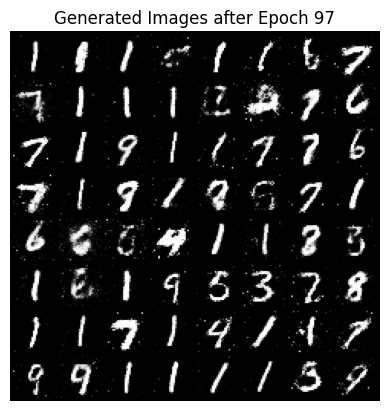

[98/150][0/469]	Loss_D: 1.0588	Loss_G: 1.9085	D(x): 0.6027	D(G(z)): 0.2100/0.2146
[98/150][100/469]	Loss_D: 0.7351	Loss_G: 1.8769	D(x): 0.7944	D(G(z)): 0.2684/0.2341
[98/150][200/469]	Loss_D: 0.8328	Loss_G: 1.7316	D(x): 0.7461	D(G(z)): 0.2706/0.2497
[98/150][300/469]	Loss_D: 0.7440	Loss_G: 1.8582	D(x): 0.7413	D(G(z)): 0.2601/0.2345
[98/150][400/469]	Loss_D: 0.6423	Loss_G: 2.1223	D(x): 0.7654	D(G(z)): 0.2037/0.1712


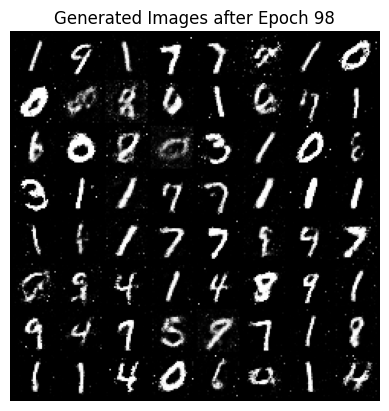

[99/150][0/469]	Loss_D: 0.8333	Loss_G: 1.9548	D(x): 0.7048	D(G(z)): 0.2056/0.2321
[99/150][100/469]	Loss_D: 0.8955	Loss_G: 1.6406	D(x): 0.7893	D(G(z)): 0.3629/0.2627
[99/150][200/469]	Loss_D: 0.8398	Loss_G: 1.4035	D(x): 0.7227	D(G(z)): 0.2426/0.3145
[99/150][300/469]	Loss_D: 0.5767	Loss_G: 2.7334	D(x): 0.7495	D(G(z)): 0.1646/0.1133
[99/150][400/469]	Loss_D: 0.6391	Loss_G: 2.3473	D(x): 0.7232	D(G(z)): 0.1352/0.1393


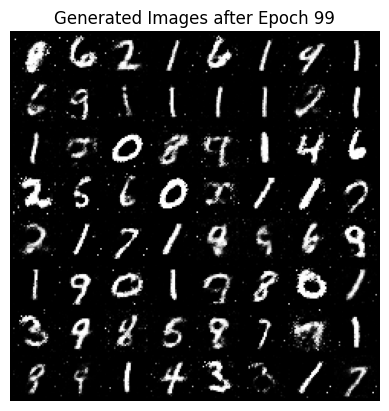

[100/150][0/469]	Loss_D: 0.8502	Loss_G: 1.7956	D(x): 0.7359	D(G(z)): 0.2581/0.2459
[100/150][100/469]	Loss_D: 0.8929	Loss_G: 1.6622	D(x): 0.7578	D(G(z)): 0.3074/0.2745
[100/150][200/469]	Loss_D: 1.0069	Loss_G: 1.3025	D(x): 0.7356	D(G(z)): 0.3905/0.3442
[100/150][300/469]	Loss_D: 0.8647	Loss_G: 1.6402	D(x): 0.6321	D(G(z)): 0.1885/0.2423
[100/150][400/469]	Loss_D: 0.8046	Loss_G: 1.7380	D(x): 0.7314	D(G(z)): 0.2674/0.2456


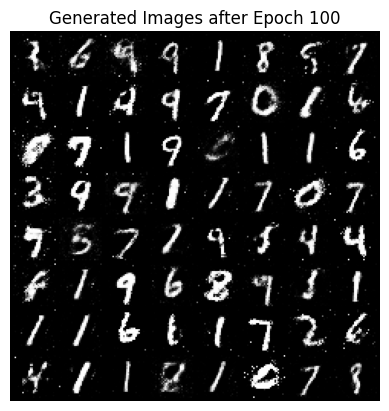

[101/150][0/469]	Loss_D: 0.8286	Loss_G: 2.2209	D(x): 0.7647	D(G(z)): 0.2778/0.1915
[101/150][100/469]	Loss_D: 1.0002	Loss_G: 1.7225	D(x): 0.6489	D(G(z)): 0.2448/0.2628
[101/150][200/469]	Loss_D: 0.7789	Loss_G: 1.3841	D(x): 0.7465	D(G(z)): 0.2942/0.3114
[101/150][300/469]	Loss_D: 0.7405	Loss_G: 1.9096	D(x): 0.7418	D(G(z)): 0.2303/0.2175
[101/150][400/469]	Loss_D: 0.7012	Loss_G: 1.9571	D(x): 0.7472	D(G(z)): 0.2105/0.2265


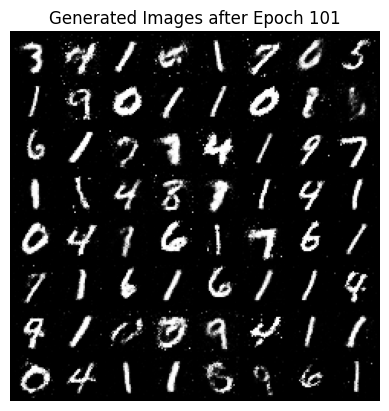

[102/150][0/469]	Loss_D: 0.7683	Loss_G: 1.7742	D(x): 0.7272	D(G(z)): 0.2477/0.2212
[102/150][100/469]	Loss_D: 0.6032	Loss_G: 1.9551	D(x): 0.7594	D(G(z)): 0.1963/0.1829
[102/150][200/469]	Loss_D: 0.7005	Loss_G: 1.9939	D(x): 0.7443	D(G(z)): 0.2262/0.1995
[102/150][300/469]	Loss_D: 0.8364	Loss_G: 1.9325	D(x): 0.7997	D(G(z)): 0.3462/0.2230
[102/150][400/469]	Loss_D: 0.8740	Loss_G: 1.8495	D(x): 0.7784	D(G(z)): 0.3461/0.2165


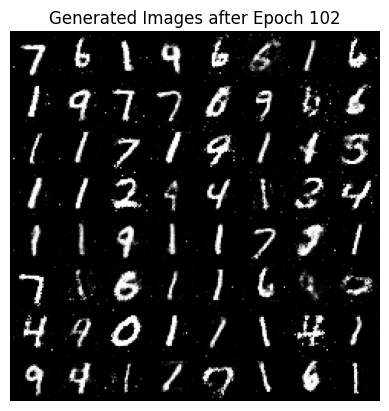

[103/150][0/469]	Loss_D: 0.5317	Loss_G: 2.3357	D(x): 0.8023	D(G(z)): 0.1791/0.1517
[103/150][100/469]	Loss_D: 1.0055	Loss_G: 1.5496	D(x): 0.7955	D(G(z)): 0.4238/0.2928
[103/150][200/469]	Loss_D: 0.8016	Loss_G: 1.4770	D(x): 0.7699	D(G(z)): 0.3183/0.3005
[103/150][300/469]	Loss_D: 0.7142	Loss_G: 1.5195	D(x): 0.7684	D(G(z)): 0.2810/0.2704
[103/150][400/469]	Loss_D: 0.7005	Loss_G: 1.7045	D(x): 0.7902	D(G(z)): 0.2988/0.2393


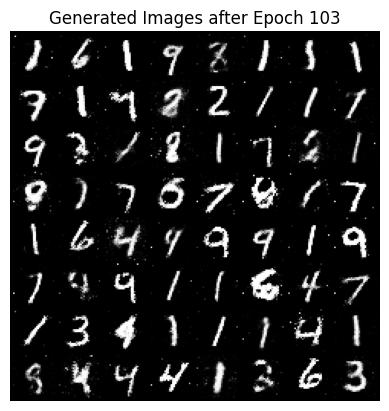

[104/150][0/469]	Loss_D: 1.0063	Loss_G: 1.6678	D(x): 0.6979	D(G(z)): 0.3273/0.2658
[104/150][100/469]	Loss_D: 0.8658	Loss_G: 1.7836	D(x): 0.7374	D(G(z)): 0.3065/0.2168
[104/150][200/469]	Loss_D: 0.8884	Loss_G: 1.5303	D(x): 0.7497	D(G(z)): 0.3252/0.3033
[104/150][300/469]	Loss_D: 0.8642	Loss_G: 1.3523	D(x): 0.7201	D(G(z)): 0.2964/0.3345
[104/150][400/469]	Loss_D: 0.8343	Loss_G: 1.7665	D(x): 0.7083	D(G(z)): 0.2509/0.2528


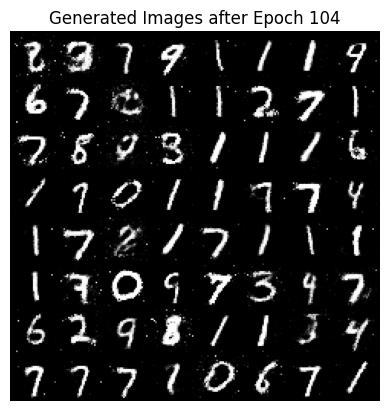

[105/150][0/469]	Loss_D: 0.9189	Loss_G: 1.6999	D(x): 0.7449	D(G(z)): 0.3194/0.2496
[105/150][100/469]	Loss_D: 0.7927	Loss_G: 1.7617	D(x): 0.6862	D(G(z)): 0.2154/0.2242
[105/150][200/469]	Loss_D: 0.8543	Loss_G: 1.9407	D(x): 0.7429	D(G(z)): 0.2830/0.2197
[105/150][300/469]	Loss_D: 0.8439	Loss_G: 1.9703	D(x): 0.7985	D(G(z)): 0.3006/0.2319
[105/150][400/469]	Loss_D: 0.8339	Loss_G: 2.1183	D(x): 0.7385	D(G(z)): 0.2534/0.1945


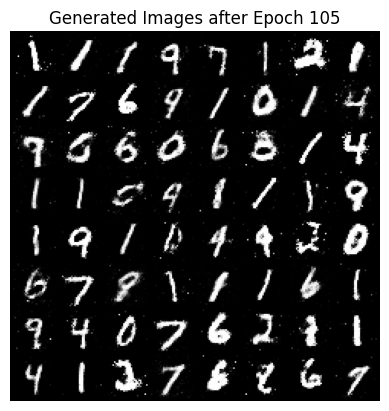

[106/150][0/469]	Loss_D: 0.8972	Loss_G: 1.7232	D(x): 0.7676	D(G(z)): 0.3364/0.2577
[106/150][100/469]	Loss_D: 0.7711	Loss_G: 2.2127	D(x): 0.6765	D(G(z)): 0.1552/0.1931
[106/150][200/469]	Loss_D: 0.7478	Loss_G: 2.0896	D(x): 0.6981	D(G(z)): 0.1780/0.1868
[106/150][300/469]	Loss_D: 0.8294	Loss_G: 1.5887	D(x): 0.6970	D(G(z)): 0.2300/0.2732
[106/150][400/469]	Loss_D: 0.9648	Loss_G: 1.6409	D(x): 0.6938	D(G(z)): 0.2919/0.2771


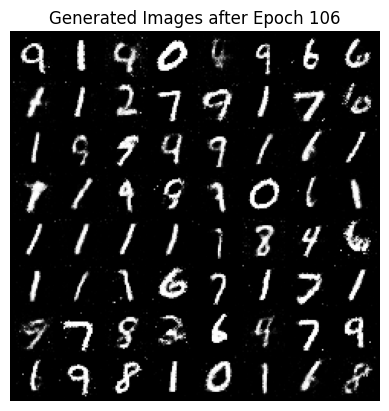

[107/150][0/469]	Loss_D: 0.7881	Loss_G: 1.4630	D(x): 0.7535	D(G(z)): 0.2956/0.3115
[107/150][100/469]	Loss_D: 0.8884	Loss_G: 1.5902	D(x): 0.7156	D(G(z)): 0.3185/0.2920
[107/150][200/469]	Loss_D: 1.0641	Loss_G: 1.7753	D(x): 0.6173	D(G(z)): 0.2563/0.2402
[107/150][300/469]	Loss_D: 0.8564	Loss_G: 1.6362	D(x): 0.6606	D(G(z)): 0.2206/0.2808
[107/150][400/469]	Loss_D: 0.7695	Loss_G: 1.3740	D(x): 0.7652	D(G(z)): 0.2980/0.3151


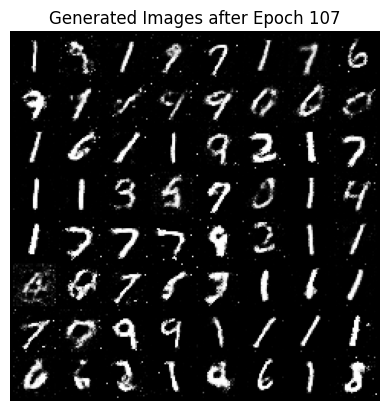

[108/150][0/469]	Loss_D: 0.8345	Loss_G: 1.9482	D(x): 0.7335	D(G(z)): 0.2862/0.2120
[108/150][100/469]	Loss_D: 0.8878	Loss_G: 1.5316	D(x): 0.7174	D(G(z)): 0.3217/0.2771
[108/150][200/469]	Loss_D: 0.8732	Loss_G: 1.3913	D(x): 0.7003	D(G(z)): 0.2606/0.3159
[108/150][300/469]	Loss_D: 0.7948	Loss_G: 1.9833	D(x): 0.7013	D(G(z)): 0.2223/0.1914
[108/150][400/469]	Loss_D: 0.8454	Loss_G: 1.9195	D(x): 0.7304	D(G(z)): 0.2895/0.2183


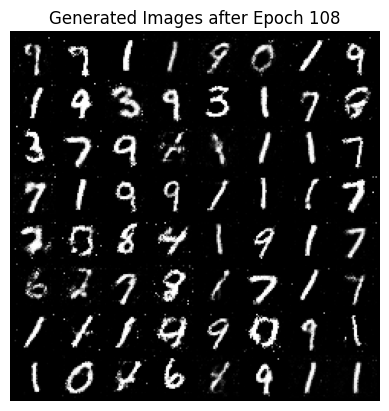

[109/150][0/469]	Loss_D: 0.6976	Loss_G: 2.5120	D(x): 0.7146	D(G(z)): 0.1859/0.1311
[109/150][100/469]	Loss_D: 0.9482	Loss_G: 1.8032	D(x): 0.6871	D(G(z)): 0.2753/0.2433
[109/150][200/469]	Loss_D: 1.0286	Loss_G: 1.6448	D(x): 0.7021	D(G(z)): 0.3365/0.2680
[109/150][300/469]	Loss_D: 0.7572	Loss_G: 1.4683	D(x): 0.7664	D(G(z)): 0.3050/0.2924
[109/150][400/469]	Loss_D: 0.7763	Loss_G: 1.8899	D(x): 0.7081	D(G(z)): 0.2172/0.2168


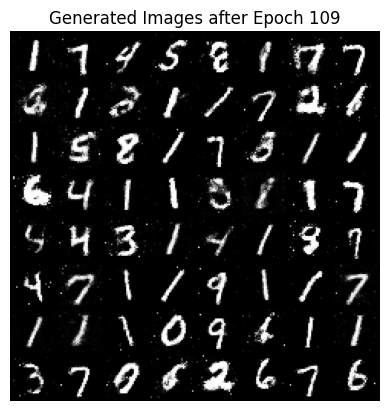

[110/150][0/469]	Loss_D: 0.8952	Loss_G: 1.5467	D(x): 0.7199	D(G(z)): 0.3204/0.2788
[110/150][100/469]	Loss_D: 0.9086	Loss_G: 1.4358	D(x): 0.7030	D(G(z)): 0.3174/0.2958
[110/150][200/469]	Loss_D: 1.0225	Loss_G: 1.4348	D(x): 0.6842	D(G(z)): 0.3014/0.3125
[110/150][300/469]	Loss_D: 0.8471	Loss_G: 1.7943	D(x): 0.8020	D(G(z)): 0.3436/0.2428
[110/150][400/469]	Loss_D: 0.7936	Loss_G: 2.1607	D(x): 0.7324	D(G(z)): 0.2612/0.1788


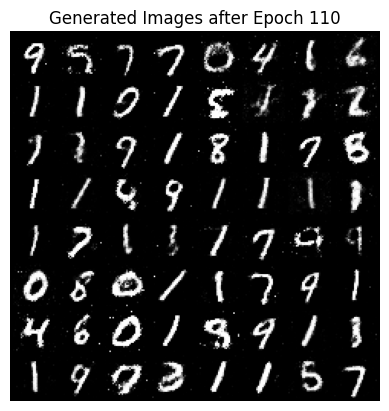

[111/150][0/469]	Loss_D: 0.8269	Loss_G: 1.4080	D(x): 0.7543	D(G(z)): 0.2892/0.3165
[111/150][100/469]	Loss_D: 0.6703	Loss_G: 1.9098	D(x): 0.7285	D(G(z)): 0.2117/0.2059
[111/150][200/469]	Loss_D: 0.8586	Loss_G: 1.5410	D(x): 0.7904	D(G(z)): 0.3645/0.2861
[111/150][300/469]	Loss_D: 1.0282	Loss_G: 1.2414	D(x): 0.6865	D(G(z)): 0.3404/0.3644
[111/150][400/469]	Loss_D: 0.9848	Loss_G: 1.4592	D(x): 0.6570	D(G(z)): 0.2710/0.3074


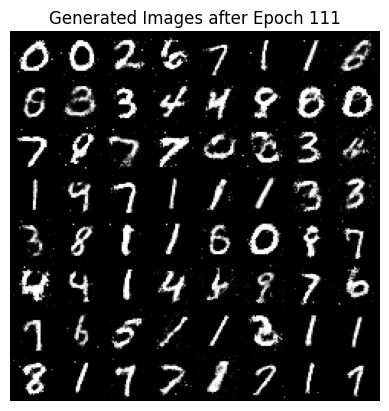

[112/150][0/469]	Loss_D: 0.7070	Loss_G: 1.8114	D(x): 0.8602	D(G(z)): 0.3611/0.2195
[112/150][100/469]	Loss_D: 0.8439	Loss_G: 1.6596	D(x): 0.7852	D(G(z)): 0.3538/0.2544
[112/150][200/469]	Loss_D: 1.0045	Loss_G: 1.2442	D(x): 0.7224	D(G(z)): 0.3774/0.3565
[112/150][300/469]	Loss_D: 0.8763	Loss_G: 1.4469	D(x): 0.7640	D(G(z)): 0.3492/0.3133
[112/150][400/469]	Loss_D: 0.8643	Loss_G: 1.9908	D(x): 0.7024	D(G(z)): 0.2631/0.2036


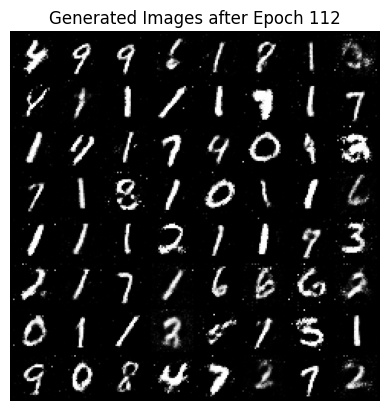

[113/150][0/469]	Loss_D: 0.9443	Loss_G: 1.5688	D(x): 0.7131	D(G(z)): 0.3016/0.2990
[113/150][100/469]	Loss_D: 0.7879	Loss_G: 1.7049	D(x): 0.6689	D(G(z)): 0.2134/0.2449
[113/150][200/469]	Loss_D: 0.8167	Loss_G: 1.5858	D(x): 0.7133	D(G(z)): 0.2865/0.2656
[113/150][300/469]	Loss_D: 0.8368	Loss_G: 1.8695	D(x): 0.7363	D(G(z)): 0.2674/0.2291
[113/150][400/469]	Loss_D: 0.8116	Loss_G: 1.5553	D(x): 0.7875	D(G(z)): 0.3514/0.2855


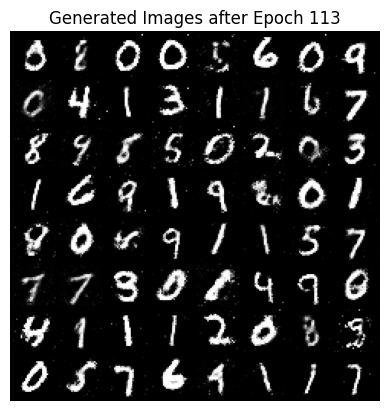

[114/150][0/469]	Loss_D: 0.9359	Loss_G: 1.3845	D(x): 0.6909	D(G(z)): 0.2906/0.3248
[114/150][100/469]	Loss_D: 0.9398	Loss_G: 1.5010	D(x): 0.7604	D(G(z)): 0.3509/0.2994
[114/150][200/469]	Loss_D: 1.0096	Loss_G: 1.7481	D(x): 0.6242	D(G(z)): 0.2427/0.2343
[114/150][300/469]	Loss_D: 0.8869	Loss_G: 1.5008	D(x): 0.6959	D(G(z)): 0.2904/0.2801
[114/150][400/469]	Loss_D: 0.9677	Loss_G: 1.5956	D(x): 0.6435	D(G(z)): 0.2654/0.2608


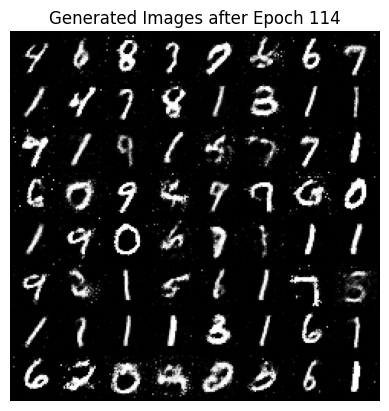

[115/150][0/469]	Loss_D: 0.8690	Loss_G: 1.6780	D(x): 0.7154	D(G(z)): 0.2806/0.2542
[115/150][100/469]	Loss_D: 0.9514	Loss_G: 1.6497	D(x): 0.6397	D(G(z)): 0.2563/0.2470
[115/150][200/469]	Loss_D: 0.7639	Loss_G: 1.4871	D(x): 0.7577	D(G(z)): 0.2986/0.2856
[115/150][300/469]	Loss_D: 0.8536	Loss_G: 2.0176	D(x): 0.7189	D(G(z)): 0.2919/0.1949
[115/150][400/469]	Loss_D: 0.8574	Loss_G: 1.9580	D(x): 0.7096	D(G(z)): 0.2710/0.2057


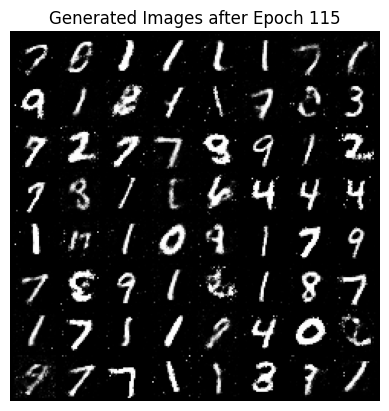

[116/150][0/469]	Loss_D: 0.9978	Loss_G: 1.3166	D(x): 0.6306	D(G(z)): 0.2457/0.3282
[116/150][100/469]	Loss_D: 0.7900	Loss_G: 1.4604	D(x): 0.7302	D(G(z)): 0.2549/0.2993
[116/150][200/469]	Loss_D: 1.0609	Loss_G: 1.6733	D(x): 0.6581	D(G(z)): 0.3173/0.2517
[116/150][300/469]	Loss_D: 0.9598	Loss_G: 1.3752	D(x): 0.6801	D(G(z)): 0.3177/0.3113
[116/150][400/469]	Loss_D: 1.0344	Loss_G: 1.3295	D(x): 0.6917	D(G(z)): 0.3413/0.3312


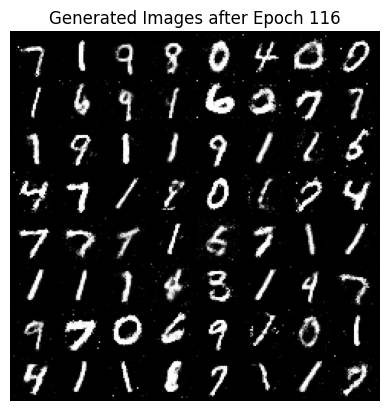

[117/150][0/469]	Loss_D: 0.9208	Loss_G: 1.3713	D(x): 0.7781	D(G(z)): 0.3528/0.3521
[117/150][100/469]	Loss_D: 0.9354	Loss_G: 1.6844	D(x): 0.7350	D(G(z)): 0.3239/0.2681
[117/150][200/469]	Loss_D: 0.7736	Loss_G: 1.7822	D(x): 0.7243	D(G(z)): 0.2709/0.2361
[117/150][300/469]	Loss_D: 0.9937	Loss_G: 1.4184	D(x): 0.7835	D(G(z)): 0.3886/0.3311
[117/150][400/469]	Loss_D: 0.7950	Loss_G: 1.6333	D(x): 0.7474	D(G(z)): 0.3111/0.2620


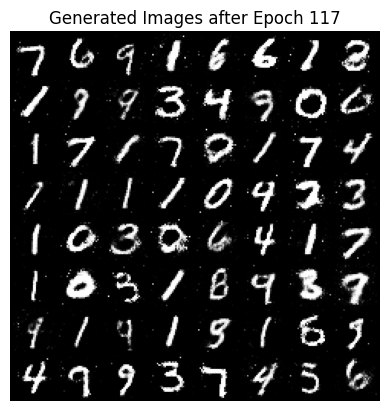

[118/150][0/469]	Loss_D: 0.9271	Loss_G: 1.2565	D(x): 0.7359	D(G(z)): 0.3540/0.3493
[118/150][100/469]	Loss_D: 1.0898	Loss_G: 1.8555	D(x): 0.6588	D(G(z)): 0.3290/0.2465
[118/150][200/469]	Loss_D: 0.8418	Loss_G: 1.5917	D(x): 0.6753	D(G(z)): 0.2532/0.2730
[118/150][300/469]	Loss_D: 0.8534	Loss_G: 1.5655	D(x): 0.7155	D(G(z)): 0.2667/0.2874
[118/150][400/469]	Loss_D: 0.7437	Loss_G: 1.7940	D(x): 0.7789	D(G(z)): 0.3055/0.2184


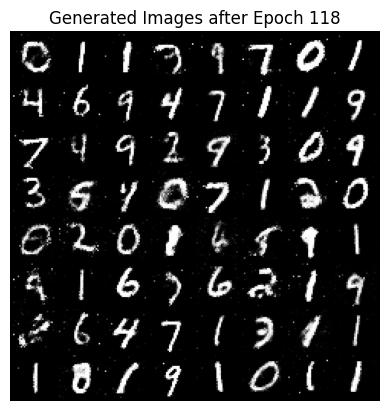

[119/150][0/469]	Loss_D: 0.9437	Loss_G: 1.4932	D(x): 0.7736	D(G(z)): 0.3764/0.3058
[119/150][100/469]	Loss_D: 0.8846	Loss_G: 1.5287	D(x): 0.8070	D(G(z)): 0.3871/0.2963
[119/150][200/469]	Loss_D: 0.9603	Loss_G: 1.5632	D(x): 0.6662	D(G(z)): 0.2759/0.2879
[119/150][300/469]	Loss_D: 1.0501	Loss_G: 1.8193	D(x): 0.6654	D(G(z)): 0.3212/0.2224
[119/150][400/469]	Loss_D: 0.6927	Loss_G: 1.9173	D(x): 0.8022	D(G(z)): 0.3021/0.2196


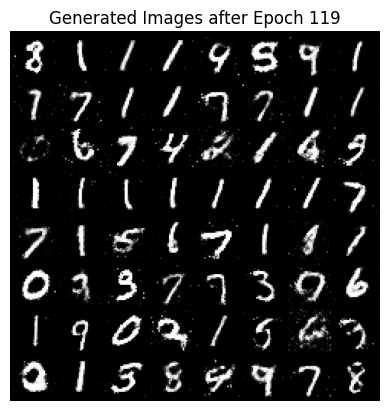

[120/150][0/469]	Loss_D: 1.0192	Loss_G: 1.7579	D(x): 0.6417	D(G(z)): 0.2857/0.2434
[120/150][100/469]	Loss_D: 0.5958	Loss_G: 2.1689	D(x): 0.7349	D(G(z)): 0.1792/0.1595
[120/150][200/469]	Loss_D: 0.9587	Loss_G: 1.4366	D(x): 0.6920	D(G(z)): 0.2962/0.3284
[120/150][300/469]	Loss_D: 0.7492	Loss_G: 1.6474	D(x): 0.7794	D(G(z)): 0.3110/0.2651
[120/150][400/469]	Loss_D: 1.1905	Loss_G: 1.4935	D(x): 0.5656	D(G(z)): 0.2818/0.3020


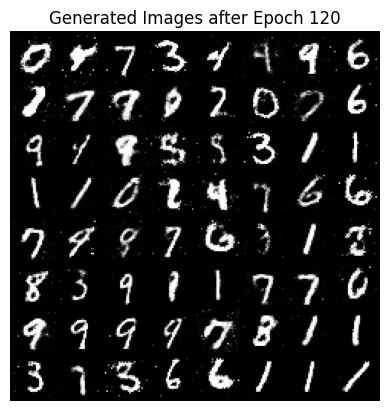

[121/150][0/469]	Loss_D: 0.9864	Loss_G: 1.6219	D(x): 0.6013	D(G(z)): 0.2043/0.2709
[121/150][100/469]	Loss_D: 0.9031	Loss_G: 1.7719	D(x): 0.6802	D(G(z)): 0.2482/0.2423
[121/150][200/469]	Loss_D: 0.9204	Loss_G: 1.5818	D(x): 0.6871	D(G(z)): 0.2883/0.2862
[121/150][300/469]	Loss_D: 0.8222	Loss_G: 1.6324	D(x): 0.6881	D(G(z)): 0.2761/0.2580
[121/150][400/469]	Loss_D: 0.9402	Loss_G: 1.3153	D(x): 0.6842	D(G(z)): 0.3275/0.3298


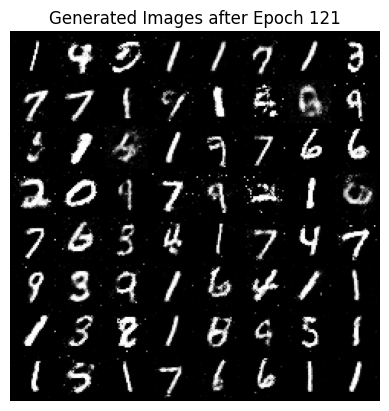

[122/150][0/469]	Loss_D: 0.7101	Loss_G: 1.4608	D(x): 0.7740	D(G(z)): 0.2853/0.2842
[122/150][100/469]	Loss_D: 0.9351	Loss_G: 1.3843	D(x): 0.7125	D(G(z)): 0.3364/0.3176
[122/150][200/469]	Loss_D: 0.9799	Loss_G: 1.4794	D(x): 0.7099	D(G(z)): 0.3614/0.2977
[122/150][300/469]	Loss_D: 0.8311	Loss_G: 1.1916	D(x): 0.7616	D(G(z)): 0.3288/0.3633
[122/150][400/469]	Loss_D: 0.8683	Loss_G: 1.4068	D(x): 0.7053	D(G(z)): 0.2787/0.3195


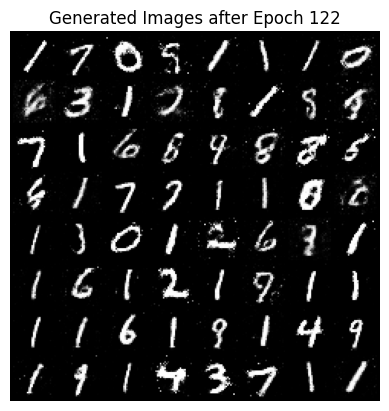

[123/150][0/469]	Loss_D: 0.8472	Loss_G: 1.7210	D(x): 0.6428	D(G(z)): 0.2140/0.2405
[123/150][100/469]	Loss_D: 0.8712	Loss_G: 1.7545	D(x): 0.6975	D(G(z)): 0.2841/0.2245
[123/150][200/469]	Loss_D: 0.8879	Loss_G: 1.6326	D(x): 0.7002	D(G(z)): 0.2981/0.2718
[123/150][300/469]	Loss_D: 0.9674	Loss_G: 2.0471	D(x): 0.6601	D(G(z)): 0.2567/0.2029
[123/150][400/469]	Loss_D: 0.7824	Loss_G: 1.6111	D(x): 0.7531	D(G(z)): 0.2963/0.2751


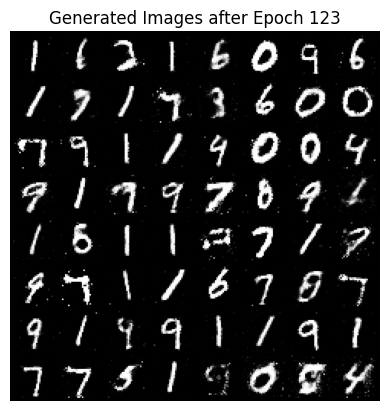

[124/150][0/469]	Loss_D: 0.9376	Loss_G: 1.5786	D(x): 0.7253	D(G(z)): 0.3282/0.2959
[124/150][100/469]	Loss_D: 0.8117	Loss_G: 1.5768	D(x): 0.7189	D(G(z)): 0.2907/0.2707
[124/150][200/469]	Loss_D: 0.8625	Loss_G: 1.1234	D(x): 0.7713	D(G(z)): 0.3449/0.4056
[124/150][300/469]	Loss_D: 0.9542	Loss_G: 1.2489	D(x): 0.6229	D(G(z)): 0.2101/0.3314
[124/150][400/469]	Loss_D: 0.9433	Loss_G: 1.4025	D(x): 0.6705	D(G(z)): 0.2848/0.3254


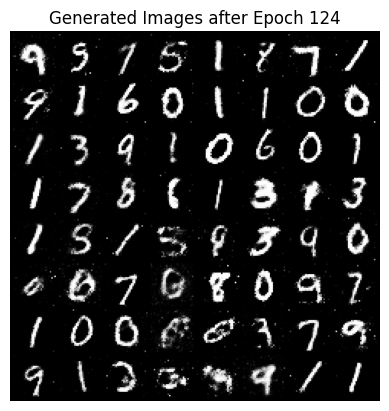

[125/150][0/469]	Loss_D: 1.0622	Loss_G: 1.4082	D(x): 0.6013	D(G(z)): 0.2576/0.3198
[125/150][100/469]	Loss_D: 0.6926	Loss_G: 2.2408	D(x): 0.7529	D(G(z)): 0.2054/0.1604
[125/150][200/469]	Loss_D: 1.0040	Loss_G: 1.4652	D(x): 0.6767	D(G(z)): 0.3523/0.2893
[125/150][300/469]	Loss_D: 1.0393	Loss_G: 1.2328	D(x): 0.7162	D(G(z)): 0.3861/0.3483
[125/150][400/469]	Loss_D: 0.9753	Loss_G: 1.2659	D(x): 0.6446	D(G(z)): 0.2984/0.3564


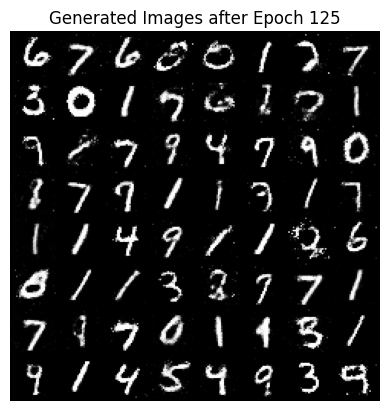

[126/150][0/469]	Loss_D: 0.9943	Loss_G: 1.6381	D(x): 0.6000	D(G(z)): 0.2211/0.2658
[126/150][100/469]	Loss_D: 1.0229	Loss_G: 1.4935	D(x): 0.7204	D(G(z)): 0.3472/0.3129
[126/150][200/469]	Loss_D: 1.1286	Loss_G: 1.4028	D(x): 0.7219	D(G(z)): 0.4240/0.3315
[126/150][300/469]	Loss_D: 0.7898	Loss_G: 1.8204	D(x): 0.6808	D(G(z)): 0.2349/0.2109
[126/150][400/469]	Loss_D: 1.1172	Loss_G: 1.3539	D(x): 0.5616	D(G(z)): 0.2349/0.3557


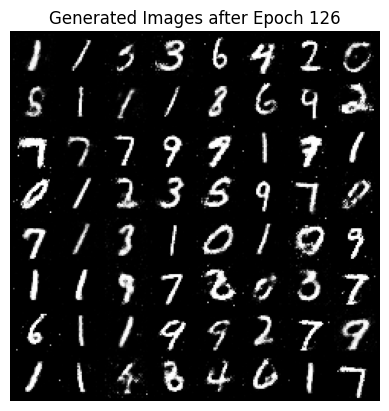

[127/150][0/469]	Loss_D: 0.8399	Loss_G: 1.4549	D(x): 0.7758	D(G(z)): 0.3294/0.3004
[127/150][100/469]	Loss_D: 0.8002	Loss_G: 1.5599	D(x): 0.7480	D(G(z)): 0.3103/0.2603
[127/150][200/469]	Loss_D: 1.0552	Loss_G: 1.1560	D(x): 0.7222	D(G(z)): 0.4164/0.3858
[127/150][300/469]	Loss_D: 1.0167	Loss_G: 1.4309	D(x): 0.6905	D(G(z)): 0.3465/0.3159
[127/150][400/469]	Loss_D: 0.7753	Loss_G: 2.0087	D(x): 0.7743	D(G(z)): 0.2959/0.2070


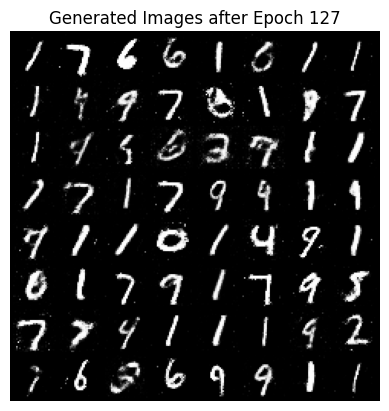

[128/150][0/469]	Loss_D: 0.9137	Loss_G: 1.5973	D(x): 0.7308	D(G(z)): 0.3405/0.2859
[128/150][100/469]	Loss_D: 0.8081	Loss_G: 1.7431	D(x): 0.7085	D(G(z)): 0.2392/0.2415
[128/150][200/469]	Loss_D: 1.1081	Loss_G: 1.1173	D(x): 0.6348	D(G(z)): 0.3432/0.3933
[128/150][300/469]	Loss_D: 0.8739	Loss_G: 2.0846	D(x): 0.6744	D(G(z)): 0.2362/0.1907
[128/150][400/469]	Loss_D: 1.0018	Loss_G: 1.3926	D(x): 0.6263	D(G(z)): 0.2860/0.3055


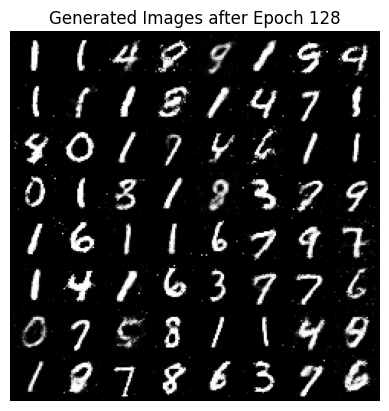

[129/150][0/469]	Loss_D: 0.7246	Loss_G: 1.5171	D(x): 0.7304	D(G(z)): 0.2567/0.2726
[129/150][100/469]	Loss_D: 0.8080	Loss_G: 1.7630	D(x): 0.7474	D(G(z)): 0.3022/0.2421
[129/150][200/469]	Loss_D: 0.8555	Loss_G: 1.5783	D(x): 0.7171	D(G(z)): 0.2996/0.2970
[129/150][300/469]	Loss_D: 0.8336	Loss_G: 1.3524	D(x): 0.7297	D(G(z)): 0.3060/0.3441
[129/150][400/469]	Loss_D: 0.9317	Loss_G: 1.7156	D(x): 0.6622	D(G(z)): 0.2933/0.2264


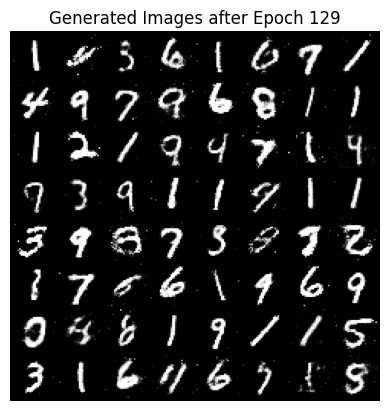

[130/150][0/469]	Loss_D: 0.8564	Loss_G: 1.7042	D(x): 0.6715	D(G(z)): 0.2540/0.2319
[130/150][100/469]	Loss_D: 1.1042	Loss_G: 1.3113	D(x): 0.6610	D(G(z)): 0.3648/0.3432
[130/150][200/469]	Loss_D: 1.1541	Loss_G: 1.2656	D(x): 0.5837	D(G(z)): 0.2560/0.3647
[130/150][300/469]	Loss_D: 0.9757	Loss_G: 1.4231	D(x): 0.6498	D(G(z)): 0.2841/0.3256
[130/150][400/469]	Loss_D: 1.1318	Loss_G: 1.6873	D(x): 0.7045	D(G(z)): 0.3969/0.2721


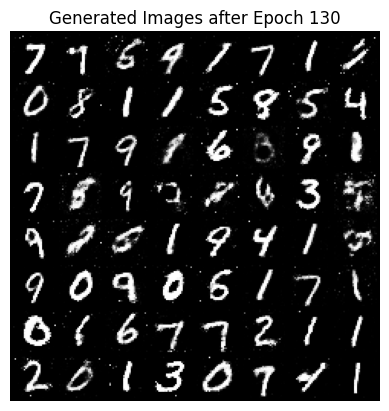

[131/150][0/469]	Loss_D: 1.0592	Loss_G: 1.4079	D(x): 0.6570	D(G(z)): 0.3204/0.3216
[131/150][100/469]	Loss_D: 0.8764	Loss_G: 1.7294	D(x): 0.6177	D(G(z)): 0.2028/0.2501
[131/150][200/469]	Loss_D: 0.9596	Loss_G: 1.4813	D(x): 0.6563	D(G(z)): 0.2458/0.2953
[131/150][300/469]	Loss_D: 0.8990	Loss_G: 1.4423	D(x): 0.7784	D(G(z)): 0.3576/0.3089
[131/150][400/469]	Loss_D: 1.0755	Loss_G: 1.3289	D(x): 0.5849	D(G(z)): 0.2877/0.3135


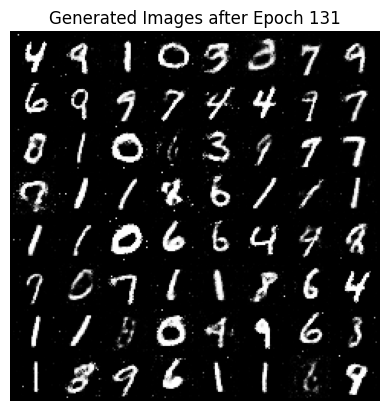

[132/150][0/469]	Loss_D: 0.9683	Loss_G: 1.1917	D(x): 0.6700	D(G(z)): 0.3174/0.3592
[132/150][100/469]	Loss_D: 0.9875	Loss_G: 1.4288	D(x): 0.6204	D(G(z)): 0.2598/0.3077
[132/150][200/469]	Loss_D: 0.8776	Loss_G: 1.4084	D(x): 0.7037	D(G(z)): 0.2817/0.3059
[132/150][300/469]	Loss_D: 0.9816	Loss_G: 1.2748	D(x): 0.6159	D(G(z)): 0.2459/0.3498
[132/150][400/469]	Loss_D: 0.9421	Loss_G: 1.5251	D(x): 0.6902	D(G(z)): 0.3199/0.2702


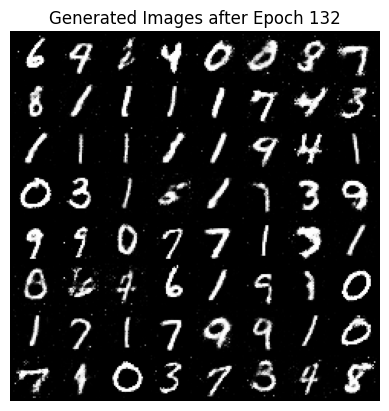

[133/150][0/469]	Loss_D: 0.9969	Loss_G: 1.3134	D(x): 0.6760	D(G(z)): 0.3350/0.3378
[133/150][100/469]	Loss_D: 1.0180	Loss_G: 1.1381	D(x): 0.6869	D(G(z)): 0.3598/0.3835
[133/150][200/469]	Loss_D: 1.0816	Loss_G: 1.2145	D(x): 0.7437	D(G(z)): 0.4477/0.3633
[133/150][300/469]	Loss_D: 0.8385	Loss_G: 1.6275	D(x): 0.7216	D(G(z)): 0.2920/0.2659
[133/150][400/469]	Loss_D: 0.8420	Loss_G: 1.7682	D(x): 0.6670	D(G(z)): 0.2444/0.2211


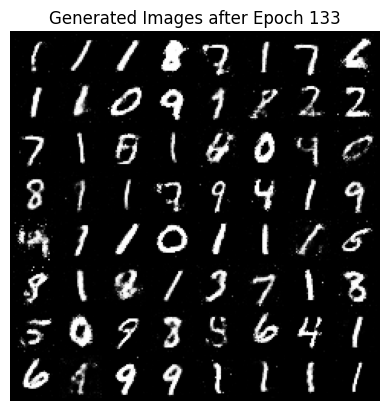

[134/150][0/469]	Loss_D: 0.8320	Loss_G: 1.6212	D(x): 0.7084	D(G(z)): 0.2942/0.2594
[134/150][100/469]	Loss_D: 0.8055	Loss_G: 2.0284	D(x): 0.6774	D(G(z)): 0.2324/0.1799
[134/150][200/469]	Loss_D: 1.1894	Loss_G: 1.1919	D(x): 0.6065	D(G(z)): 0.3407/0.3652
[134/150][300/469]	Loss_D: 0.9284	Loss_G: 1.6563	D(x): 0.6863	D(G(z)): 0.2774/0.2650
[134/150][400/469]	Loss_D: 0.8504	Loss_G: 1.6963	D(x): 0.7144	D(G(z)): 0.2939/0.2597


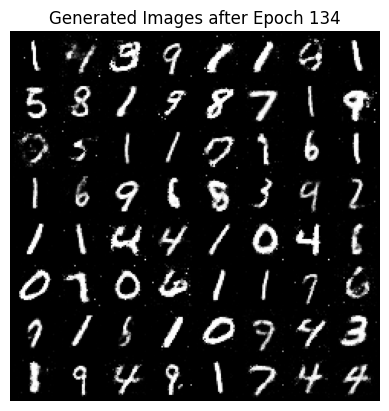

[135/150][0/469]	Loss_D: 0.9458	Loss_G: 1.5809	D(x): 0.6600	D(G(z)): 0.2799/0.2769
[135/150][100/469]	Loss_D: 0.8558	Loss_G: 1.4380	D(x): 0.7346	D(G(z)): 0.3412/0.2873
[135/150][200/469]	Loss_D: 1.0475	Loss_G: 1.4689	D(x): 0.7383	D(G(z)): 0.3920/0.3028
[135/150][300/469]	Loss_D: 0.9388	Loss_G: 1.5565	D(x): 0.6885	D(G(z)): 0.3299/0.2814
[135/150][400/469]	Loss_D: 0.7671	Loss_G: 1.5956	D(x): 0.7482	D(G(z)): 0.3000/0.2655


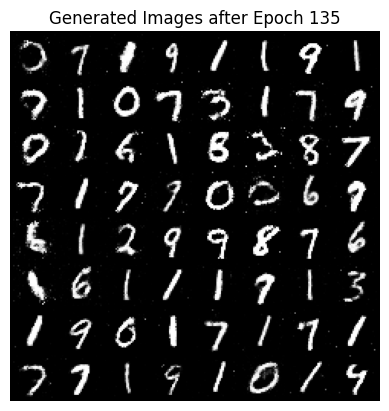

[136/150][0/469]	Loss_D: 0.8940	Loss_G: 1.5234	D(x): 0.6942	D(G(z)): 0.2807/0.2819
[136/150][100/469]	Loss_D: 0.8544	Loss_G: 1.9195	D(x): 0.6506	D(G(z)): 0.2434/0.1997
[136/150][200/469]	Loss_D: 0.9332	Loss_G: 1.6894	D(x): 0.6455	D(G(z)): 0.2328/0.2559
[136/150][300/469]	Loss_D: 0.9394	Loss_G: 1.8033	D(x): 0.7093	D(G(z)): 0.3506/0.2287
[136/150][400/469]	Loss_D: 0.8935	Loss_G: 1.3918	D(x): 0.7132	D(G(z)): 0.3147/0.3124


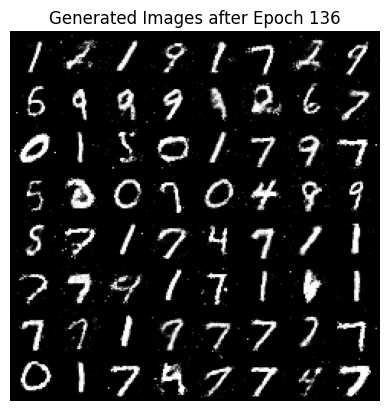

[137/150][0/469]	Loss_D: 1.0047	Loss_G: 1.2248	D(x): 0.6634	D(G(z)): 0.3446/0.3553
[137/150][100/469]	Loss_D: 0.9562	Loss_G: 1.4588	D(x): 0.7683	D(G(z)): 0.3985/0.2939
[137/150][200/469]	Loss_D: 0.9868	Loss_G: 1.2379	D(x): 0.6807	D(G(z)): 0.3381/0.3430
[137/150][300/469]	Loss_D: 0.9532	Loss_G: 1.4764	D(x): 0.6261	D(G(z)): 0.2824/0.2855
[137/150][400/469]	Loss_D: 0.8974	Loss_G: 1.4969	D(x): 0.6849	D(G(z)): 0.3019/0.2971


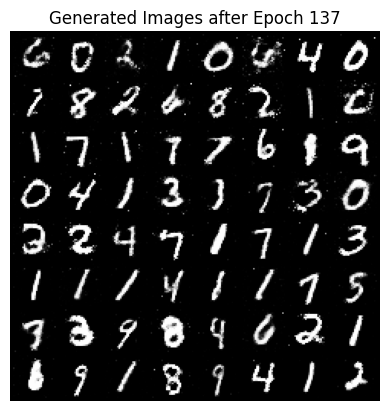

[138/150][0/469]	Loss_D: 0.8318	Loss_G: 1.4612	D(x): 0.7467	D(G(z)): 0.3242/0.2824
[138/150][100/469]	Loss_D: 0.8510	Loss_G: 1.9516	D(x): 0.7430	D(G(z)): 0.3153/0.2046
[138/150][200/469]	Loss_D: 0.9135	Loss_G: 1.4183	D(x): 0.6816	D(G(z)): 0.2738/0.3161
[138/150][300/469]	Loss_D: 0.8600	Loss_G: 1.4572	D(x): 0.7601	D(G(z)): 0.3600/0.2966
[138/150][400/469]	Loss_D: 1.0162	Loss_G: 1.6657	D(x): 0.6709	D(G(z)): 0.3285/0.2720


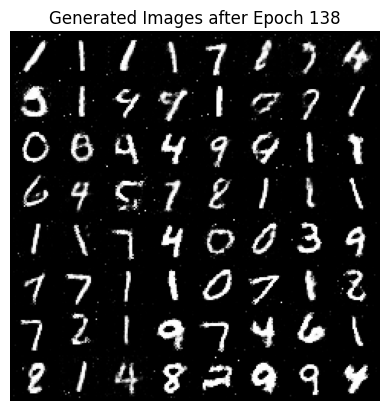

[139/150][0/469]	Loss_D: 0.9822	Loss_G: 1.2251	D(x): 0.7499	D(G(z)): 0.3972/0.3564
[139/150][100/469]	Loss_D: 1.0543	Loss_G: 1.2385	D(x): 0.6268	D(G(z)): 0.2989/0.3645
[139/150][200/469]	Loss_D: 0.9373	Loss_G: 1.5043	D(x): 0.6187	D(G(z)): 0.2556/0.2800
[139/150][300/469]	Loss_D: 0.8755	Loss_G: 1.4367	D(x): 0.7056	D(G(z)): 0.3191/0.3127
[139/150][400/469]	Loss_D: 1.0018	Loss_G: 1.2914	D(x): 0.7421	D(G(z)): 0.4156/0.3266


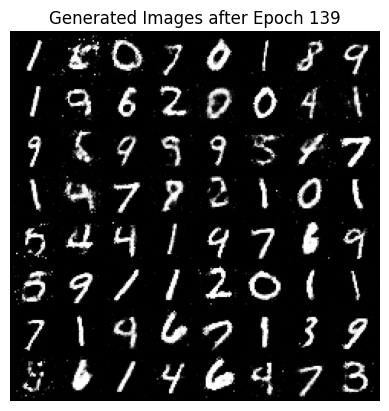

[140/150][0/469]	Loss_D: 0.9826	Loss_G: 1.4470	D(x): 0.7061	D(G(z)): 0.3369/0.3146
[140/150][100/469]	Loss_D: 0.9428	Loss_G: 1.6495	D(x): 0.6959	D(G(z)): 0.3400/0.2458
[140/150][200/469]	Loss_D: 0.8311	Loss_G: 1.8647	D(x): 0.6886	D(G(z)): 0.2513/0.2235
[140/150][300/469]	Loss_D: 0.9974	Loss_G: 1.5603	D(x): 0.6594	D(G(z)): 0.3082/0.2831
[140/150][400/469]	Loss_D: 0.9862	Loss_G: 1.4900	D(x): 0.6068	D(G(z)): 0.2506/0.3040


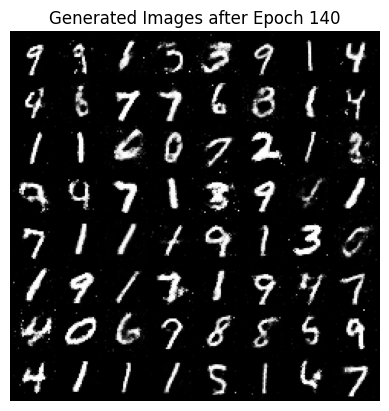

[141/150][0/469]	Loss_D: 0.8833	Loss_G: 1.7255	D(x): 0.6394	D(G(z)): 0.2115/0.2586
[141/150][100/469]	Loss_D: 0.9427	Loss_G: 1.7215	D(x): 0.6749	D(G(z)): 0.3201/0.2402
[141/150][200/469]	Loss_D: 0.8646	Loss_G: 1.8198	D(x): 0.6617	D(G(z)): 0.2534/0.2185
[141/150][300/469]	Loss_D: 0.9638	Loss_G: 1.2140	D(x): 0.6953	D(G(z)): 0.3372/0.3748
[141/150][400/469]	Loss_D: 0.9868	Loss_G: 1.3052	D(x): 0.6242	D(G(z)): 0.2676/0.3371


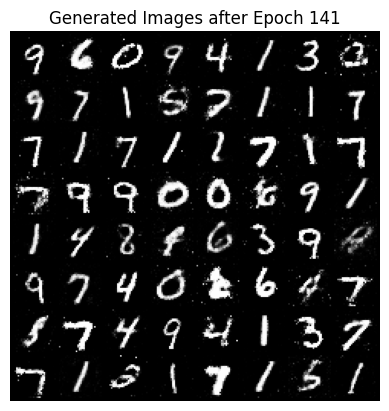

[142/150][0/469]	Loss_D: 0.7628	Loss_G: 1.5054	D(x): 0.7345	D(G(z)): 0.3040/0.2735
[142/150][100/469]	Loss_D: 0.8439	Loss_G: 2.2418	D(x): 0.6840	D(G(z)): 0.2437/0.1719
[142/150][200/469]	Loss_D: 0.8594	Loss_G: 1.8663	D(x): 0.6485	D(G(z)): 0.2305/0.2127
[142/150][300/469]	Loss_D: 0.8755	Loss_G: 1.6168	D(x): 0.6802	D(G(z)): 0.2689/0.2654
[142/150][400/469]	Loss_D: 0.8271	Loss_G: 1.3216	D(x): 0.7650	D(G(z)): 0.3695/0.3120


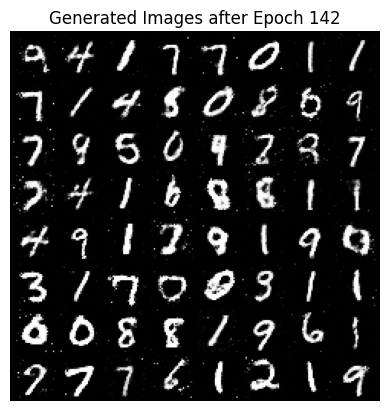

[143/150][0/469]	Loss_D: 0.8750	Loss_G: 1.7808	D(x): 0.6637	D(G(z)): 0.2525/0.2270
[143/150][100/469]	Loss_D: 0.8619	Loss_G: 1.5914	D(x): 0.6631	D(G(z)): 0.2374/0.2770
[143/150][200/469]	Loss_D: 0.9430	Loss_G: 1.4079	D(x): 0.6861	D(G(z)): 0.3048/0.3180
[143/150][300/469]	Loss_D: 0.9128	Loss_G: 1.4641	D(x): 0.7301	D(G(z)): 0.3242/0.3080
[143/150][400/469]	Loss_D: 0.8812	Loss_G: 2.1027	D(x): 0.6377	D(G(z)): 0.2090/0.1792


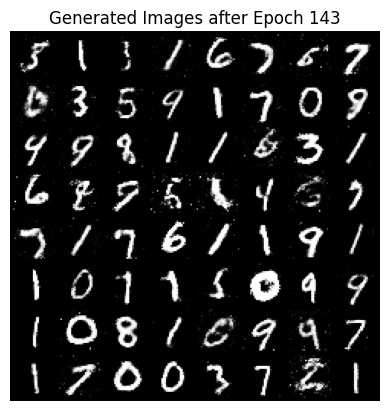

[144/150][0/469]	Loss_D: 1.0206	Loss_G: 1.3533	D(x): 0.6353	D(G(z)): 0.3112/0.3237
[144/150][100/469]	Loss_D: 1.0573	Loss_G: 1.3132	D(x): 0.7272	D(G(z)): 0.4015/0.3282
[144/150][200/469]	Loss_D: 1.0073	Loss_G: 1.3912	D(x): 0.6909	D(G(z)): 0.3711/0.3044
[144/150][300/469]	Loss_D: 1.0238	Loss_G: 1.6837	D(x): 0.5778	D(G(z)): 0.2149/0.2524
[144/150][400/469]	Loss_D: 1.1008	Loss_G: 1.4074	D(x): 0.6676	D(G(z)): 0.3691/0.3079


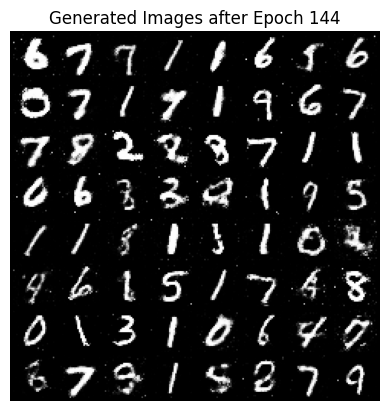

[145/150][0/469]	Loss_D: 1.0465	Loss_G: 1.1687	D(x): 0.7279	D(G(z)): 0.4090/0.3808
[145/150][100/469]	Loss_D: 1.1962	Loss_G: 1.1901	D(x): 0.6706	D(G(z)): 0.4160/0.3746
[145/150][200/469]	Loss_D: 0.9850	Loss_G: 1.4249	D(x): 0.6578	D(G(z)): 0.3231/0.3042
[145/150][300/469]	Loss_D: 1.1136	Loss_G: 1.3383	D(x): 0.6088	D(G(z)): 0.3094/0.3265
[145/150][400/469]	Loss_D: 0.9537	Loss_G: 1.7318	D(x): 0.6494	D(G(z)): 0.2770/0.2298


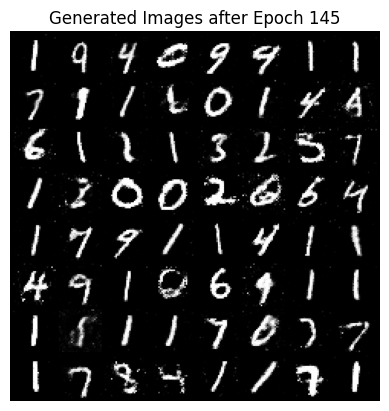

[146/150][0/469]	Loss_D: 1.0195	Loss_G: 1.3980	D(x): 0.6342	D(G(z)): 0.2881/0.3100
[146/150][100/469]	Loss_D: 1.0309	Loss_G: 1.4043	D(x): 0.6759	D(G(z)): 0.3470/0.3097
[146/150][200/469]	Loss_D: 0.9032	Loss_G: 1.4534	D(x): 0.7125	D(G(z)): 0.3385/0.3051
[146/150][300/469]	Loss_D: 0.9970	Loss_G: 1.1437	D(x): 0.7728	D(G(z)): 0.4128/0.4017
[146/150][400/469]	Loss_D: 0.8876	Loss_G: 1.6579	D(x): 0.6789	D(G(z)): 0.2769/0.2416


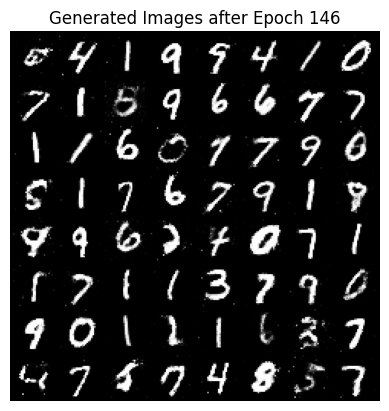

[147/150][0/469]	Loss_D: 1.0732	Loss_G: 1.4357	D(x): 0.6444	D(G(z)): 0.3164/0.3014
[147/150][100/469]	Loss_D: 1.0068	Loss_G: 1.0488	D(x): 0.6913	D(G(z)): 0.3606/0.4024
[147/150][200/469]	Loss_D: 1.1715	Loss_G: 1.2477	D(x): 0.6039	D(G(z)): 0.3277/0.3636
[147/150][300/469]	Loss_D: 0.7762	Loss_G: 1.6884	D(x): 0.7609	D(G(z)): 0.3044/0.2516
[147/150][400/469]	Loss_D: 0.9287	Loss_G: 1.6660	D(x): 0.7071	D(G(z)): 0.3256/0.2534


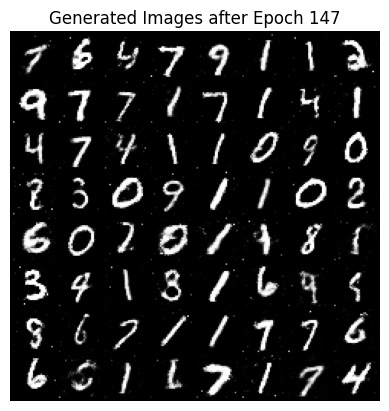

[148/150][0/469]	Loss_D: 0.8974	Loss_G: 1.4390	D(x): 0.7155	D(G(z)): 0.3076/0.3011
[148/150][100/469]	Loss_D: 0.9306	Loss_G: 1.4367	D(x): 0.7668	D(G(z)): 0.3732/0.3222
[148/150][200/469]	Loss_D: 0.8990	Loss_G: 1.8749	D(x): 0.6943	D(G(z)): 0.2772/0.2338
[148/150][300/469]	Loss_D: 0.8418	Loss_G: 1.5497	D(x): 0.7262	D(G(z)): 0.2835/0.2868
[148/150][400/469]	Loss_D: 0.9869	Loss_G: 1.4121	D(x): 0.6088	D(G(z)): 0.2554/0.3129


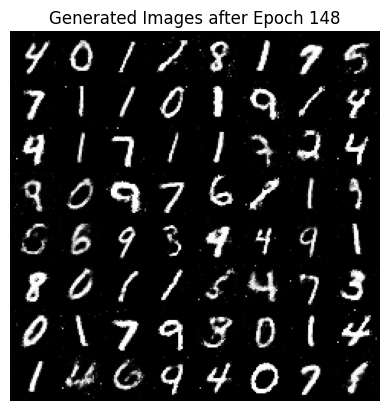

[149/150][0/469]	Loss_D: 1.1404	Loss_G: 1.2136	D(x): 0.7594	D(G(z)): 0.4477/0.3724
[149/150][100/469]	Loss_D: 0.9574	Loss_G: 1.6240	D(x): 0.7739	D(G(z)): 0.4140/0.2644
[149/150][200/469]	Loss_D: 0.8868	Loss_G: 1.4611	D(x): 0.7393	D(G(z)): 0.3429/0.3110
[149/150][300/469]	Loss_D: 1.0620	Loss_G: 1.1279	D(x): 0.6532	D(G(z)): 0.3509/0.3944
[149/150][400/469]	Loss_D: 0.9949	Loss_G: 1.3366	D(x): 0.6406	D(G(z)): 0.2760/0.3350


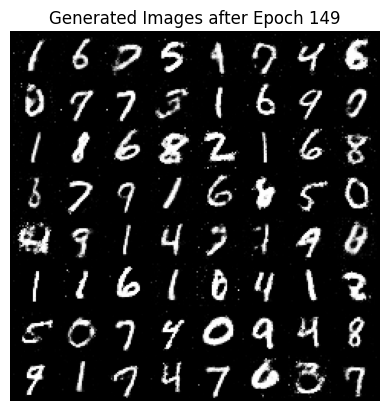

[150/150][0/469]	Loss_D: 0.9258	Loss_G: 1.5238	D(x): 0.6860	D(G(z)): 0.3322/0.2657
[150/150][100/469]	Loss_D: 0.9103	Loss_G: 1.5481	D(x): 0.8162	D(G(z)): 0.4043/0.2922
[150/150][200/469]	Loss_D: 0.9376	Loss_G: 1.4027	D(x): 0.7062	D(G(z)): 0.3325/0.3170
[150/150][300/469]	Loss_D: 0.8840	Loss_G: 1.1608	D(x): 0.6732	D(G(z)): 0.2935/0.3618
[150/150][400/469]	Loss_D: 0.9972	Loss_G: 1.1567	D(x): 0.6549	D(G(z)): 0.3108/0.3753


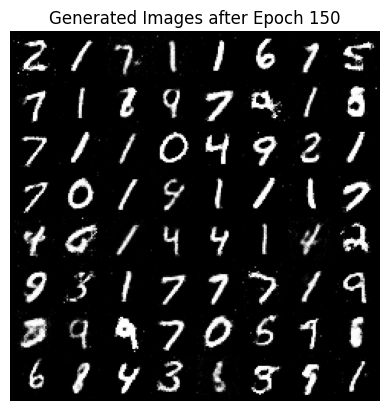

Training finished.


In [ ]:
# Lists to keep track of progress
G_losses = []
D_losses = []

# Training loop
print("Starting Training...")

for epoch in range(num_epochs):
    for i, (data, _) in enumerate(train_loader):
        ############################
        # (1) Update Discriminator: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with real images
        D.zero_grad()
        real_data = data.to(device)
        b_size = real_data.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = D(real_data).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with fake images
        noise = torch.randn(b_size, noise_size, device=device)
        fake_data = G(noise)
        label.fill_(fake_label)
        output = D(fake_data.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        ############################
        # (2) Update Generator: maximize log(D(G(z)))
        ###########################
        G.zero_grad()
        label.fill_(real_label)  # Generator wants the discriminator to believe the fake images are real
        output = D(fake_data).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        # Output training stats
        if i % 100 == 0:
            print(f'[{epoch+1}/{num_epochs}][{i}/{len(train_loader)}]\t'
                  f'Loss_D: {errD.item():.4f}\tLoss_G: {errG.item():.4f}\t'
                  f'D(x): {D_x:.4f}\tD(G(z)): {D_G_z1:.4f}/{D_G_z2:.4f}')

    # Save losses for plotting later
    G_losses.append(errG.item())
    D_losses.append(errD.item())

    # Generate and save images at the end of each epoch
    with torch.no_grad():
        fixed_noise = torch.randn(64, noise_size, device=device)
        fake = G(fixed_noise).detach().cpu()
        grid = torchvision.utils.make_grid(fake, padding=2, normalize=True)
        plt.imshow(np.transpose(grid, (1, 2, 0)))
        plt.title(f'Generated Images after Epoch {epoch+1}')
        plt.axis('off')
        plt.show()

print("Training finished.")

Explanation:

- Discriminator Training:

 - Real Images: Compute loss and gradients for correctly classifying real images.

 - Fake Images: Compute loss and gradients for correctly classifying generated images as fake.

 - Update Discriminator: Optimize discriminator weights based on the total loss.

- Generator Training:

 - Goal: Generate images that the discriminator classifies as real.

 - Compute Loss: Based on the discriminator's output for generated images, but using the label real_label because the generator wants to fool the discriminator.

 - Update Generator: Optimize generator weights to minimize this loss.

- Progress Tracking: Every 100 batches, we print out the losses and outputs to monitor training.

- Visualization: At the end of each epoch, we generate a grid of images to visualize the progress of the generator.

**Visualizing Training Progress**

We plot the generator and discriminator losses over time to analyze training.

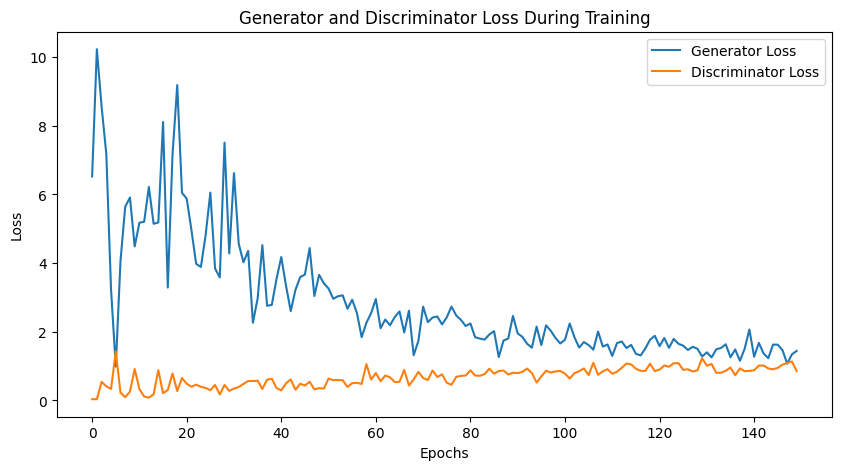

In [ ]:
# Plot the losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label='Generator Loss')
plt.plot(D_losses, label='Discriminator Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()